Project 4: Generative Adversarial Networks
======
In this project, you are expected to fill in the missing parts of a PyTorch implementation of the Deep Convolutional Generative Adversarial Network (DCGAN) [1] and test its performance on several datasets.<br>
Please **read the instructions carefully**. We provide reference outputs for most tasks and we will judge your solution based on your code as well as on the quality of your output and similarity to our results.

We will be using datasets with small images for this project, because high-resolution GANs take notoriously long to train.

**References:**

[1] [Radford, A., Metz, L. and Chintala, S., 2015. Unsupervised representation learning with deep convolutional generative adversarial networks. arXiv preprint arXiv:1511.06434.](https://arxiv.org/abs/1511.06434)

[2] [MNIST dataset.](http://yann.lecun.com/exdb/mnist/)

[3] [FashionMNIST dataset.](https://github.com/zalandoresearch/fashion-mnist)

[4] [UTKFace dataset.](https://susanqq.github.io/UTKFace/)

## Assignment 4A: DCGAN

### Verify your PyTorch installation

In [1]:
import torch
import torchvision

# Print Basic Information
print('Torch', torch.__version__, 'CUDA', torch.version.cuda)
print("Torchvision", torchvision.__version__)
print('Device:', torch.device('cuda:0'))

Torch 1.3.0 CUDA 10.0.130
Torchvision 0.4.1a0+d94043a
Device: cuda:0


In [2]:
#import statements
import os, time
import matplotlib.pyplot as plt
import itertools
import pickle
import imageio
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torchvision import datasets, transforms, utils
from torch.autograd import Variable
from torchsummary import summary
import numpy as np

### 1) Load and prepare the dataset (5 points)

Pick either _MNIST_ [2] or _FashionMNIST_ [3] as your dataset for this assignment. Both datasets contain grayscale images with a natural resolution of $28\times28$ pixels, have 10 classes and can be imported from `torchvision.datasets`.<br>
The color channels in the _MNIST_ as well as in _FashionMNIST_ dataset are stored inverted, ie with white content on a black background. This is because, per default, convolution layers in the network add zero-padding to the image, hence a black background works more naturally and yields better results during training.
We do, however, want to show our results with **black content** on a **white background**. To that end, **add appropriate functionality** in the plotting/visualization functions throughout this notebook to invert and clamp the image values (see below visualization).

<img src="img/mnist_example.JPG" width="800">
<img src="img/fashion_mnist_example.JPG" width="800">


Implement the data loading, create the necessary **data transforms** such that your training images have $32\times32$ pixels, and have a value range between $[-1, 1]$:

Consider whether you can implement some **data augmentation**, and if possible, do so.

In [3]:
#######################################################################################################
# TODO 1: Load dataset. Implement the necessary functions so your data has a resolution of 32x32 pixels
# and the values are normalized to a [-1, 1] range. 
# Consider whether you can implement some data augmentation, and if possible, do so.
#######################################################################################################
# transform = transforms.Compose([transforms.ToTensor(), transforms.Normalize((0.5,), (1.0,))])
transform = transforms.Compose([
            transforms.Resize(32),
            transforms.RandomRotation(5),
            transforms.ToTensor(),
            transforms.Normalize((0.5,),(0.5,))
        ])

train_dataset = datasets.MNIST(root = "./data/",
                            transform=transform,
                            train = True,
                            download = True)


print("Dataset length: ", len(train_dataset))
print("Image size: {}".format(train_dataset[0][0].size()))
print("value range: [ {} - {} ]".format(torch.min(train_dataset[0][0]), torch.max(train_dataset[0][0])))

Dataset length:  60000
Image size: torch.Size([1, 32, 32])
value range: [ -1.0 - 0.9843137264251709 ]


#### Inspect the training data

**Visualize a few examples** from your training data.

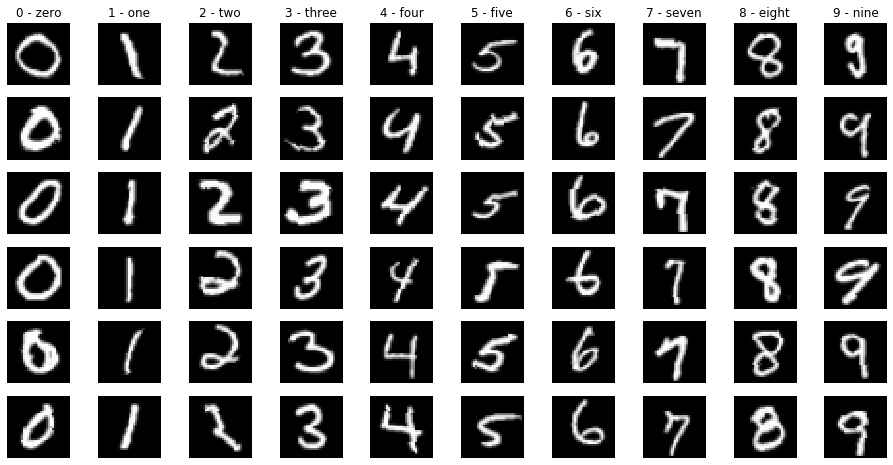

In [4]:
labels = train_dataset.classes
fig = plt.figure(figsize=(16, 8))
rows = 6

images = {}
for label in range(len(labels)):
    images[label] = []

#find some images for each label    
for x in range(1000):
    rand = np.random.randint(len(train_dataset))
    label = train_dataset[rand][1]
    if len(images[label]) > rows:
        continue
    images[label].append(train_dataset[rand][0][0,:,:])
    
for label in range(len(labels)):
    for row in range(rows):
        image = images[label][row]
        fig.add_subplot(rows, len(labels), row * len(labels) + label + 1)
        plt.axis('off')
        plt.imshow(image, cmap='gray')
        if row == 0:
            plt.title(labels[label])
plt.show()

### 2) Choose appropriate hyperparameters for the training (4 points)

In [5]:
#######################################################################################################
# TODO 2: choose sensible training parameters for DCGAN training. 
# Start with few epochs while you design the network, and increase once you think you have a good setup.
# Since GANs train slowly, you may have to use at quite a few epochs to see good results.
#######################################################################################################
batch_size = 128 
lr = 0.0002
num_epochs = 20

### 3) Implement the generator network (8 points)
The expected output of this GAN should look like this (or better):

<img src="img/DCGAN_MNIST.png" align='left' width="355">
<img src="img/DCGAN_fashionMNIST.png" align='left' width="355">

Implement the **DCGAN Generator** and **Discriminator** networks for an output size of $32\times32$ pixels according to the given network diagrams. 

<img src="img/DCGAN_Generator.png" align='left' width="800">

Create a function to initialize the weights for `nn.Conv2d` and `nn.ConvTranspose2d` layers with a custom distribution. To that end, complete the function `normal_init`, which initialized the weights of the given pytorch layer with a Normal distribution centered around $mean$ and a standard deviation $std$.

##### Hint: 
`summary` from the `torchsummary` package is a very helpful tool to inspect the layers in your network. Use it like so:

```
M = MyNetwork()
M.cuda()
summary(M, input_size=myExpectedInputSize)
```

In [6]:
#######################################################################################################
# TODO 3a: implement a function that initializes the layer's weights with mean and standard deviation.
#######################################################################################################

def normal_init(layer, mean, std):
    # layer.weight tensor
    # layer.weight.data values
    nn.init.normal_(layer.weight.data, mean, std)

        
#     if isinstance(layer, nn.Conv2d) or isinstance(layer, nn.ConvTranspose2d):
#         return torch.nn.init.normal_(layer.weight, mean, std)    

In [7]:
#######################################################################################################
# TODO 3b: implement the generator network for a DCGAN with output size 32x32px
#######################################################################################################
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()

        # Input is the latent vector Z.100
        self.tconv1 = nn.ConvTranspose2d(100, 512,
            kernel_size=4, bias=False)
        self.bn1 = nn.BatchNorm2d(512)
        self.relu1 = nn.ReLU(True)

        # Input Dimension: 512*4*4
        self.tconv2 = nn.ConvTranspose2d(512, 256,
            4, 2, 1, bias=False)
        self.bn2 = nn.BatchNorm2d(256)
        self.relu2 = nn.ReLU(True)

        # Input Dimension: 256 x 8 x 8
        self.tconv3 = nn.ConvTranspose2d(256, 128,
            4, 2, 1, bias=False)
        self.bn3 = nn.BatchNorm2d(128)
        self.relu3 = nn.ReLU(True)

        # Input Dimension: 128 x 16 x 16
        self.tconv4 = nn.ConvTranspose2d(128, 1,
            4, 2, 1, bias=False)


    def forward(self, x):
        x = self.relu1(self.bn1(self.tconv1(x)))
        x = self.relu2(self.bn2(self.tconv2(x)))
        x = self.relu3(self.bn3(self.tconv3(x)))

        x = torch.tanh(self.tconv4(x))

        return x




In [8]:
# weight_init
def weight_init(layer, mean = 0, std = 0.02):
        # get class names
        classname = layer.__class__.__name__
        if classname.find('conv') != -1:
            normal_init(layer, mean, std)

In [9]:
def create_model_gpu(model):
    model = model()
    model = model.cuda()
    return model

Generator = create_model_gpu(Generator)
print('Ready to train.')

Ready to train.


In [10]:
#import torchvision.models as models
#from collections import OrderedDict
from torchsummary import summary

## summarize the parameters
summary(Generator, input_size=(100, 1, 1))


----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
   ConvTranspose2d-1            [-1, 512, 4, 4]         819,200
       BatchNorm2d-2            [-1, 512, 4, 4]           1,024
              ReLU-3            [-1, 512, 4, 4]               0
   ConvTranspose2d-4            [-1, 256, 8, 8]       2,097,152
       BatchNorm2d-5            [-1, 256, 8, 8]             512
              ReLU-6            [-1, 256, 8, 8]               0
   ConvTranspose2d-7          [-1, 128, 16, 16]         524,288
       BatchNorm2d-8          [-1, 128, 16, 16]             256
              ReLU-9          [-1, 128, 16, 16]               0
  ConvTranspose2d-10            [-1, 1, 32, 32]           2,048
Total params: 3,444,480
Trainable params: 3,444,480
Non-trainable params: 0
----------------------------------------------------------------
Input size (MB): 0.00
Forward/backward pass size (MB): 1.32
Params size (MB): 13.14
Estima

### 4) Implement the discriminator network (8 points)
<img src="img/DCGAN_Discriminator.png" align='left' width="800">

In [11]:
#######################################################################################################
# TODO 3c: implement the discriminator network for a DCGAN with input size 32x32px
#######################################################################################################
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        
        # Input Dimension: 1 x 32 x 32
        # torch.nn.Conv2d(in_channels, out_channels, kernel_size, 
        #          stride=1, padding=0, dilation=1, groups=1, bias=True, padding_mode='zeros')
        self.conv1 = nn.Conv2d(1, 128,
            kernel_size = 4, stride = 2, padding = 1, bias=False)
        self.leaky_relu1 = nn.LeakyReLU(0.2, True)
        
        # Input Dimension: 128*16*16
        # torch.nn.BatchNorm2d(num_features, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv2 = nn.Conv2d(128,256,
            4, 2, 1, bias=False)
        self.bn2 = nn.BatchNorm2d(256)
        self.leaky_relu2 = nn.LeakyReLU(0.2, True)

        # Input Dimension: 256*8*8
        self.conv3 = nn.Conv2d(256, 512,
            4, 2, 1, bias=False)
        self.bn3 = nn.BatchNorm2d(512)
        self.leaky_relu3 = nn.LeakyReLU(0.2, True)

        # Input Dimension: 512*4*4
        self.conv4 = nn.Conv2d(512, 1,
            4, 1, bias=False)
        self.leaky_relu4 = nn.LeakyReLU(0.2, True)

 
    # forward method
    def forward(self, input):
        x = self.leaky_relu1(self.conv1(input))
        x = self.leaky_relu2(self.bn2(self.conv2(x)))
        x = self.leaky_relu3(self.bn3(self.conv3(x)))
        x = self.leaky_relu4(self.conv4(x))

        x = torch.sigmoid(x)

        return x
    
# weight_init
#def weight_init(self, mean, std):
#    pass # TODO add your implementation



    

In [12]:
Discriminator = create_model_gpu(Discriminator)
print('Ready to train.')

Ready to train.


In [13]:
#from torchsummary import summary

## summarize the parameters
summary(Discriminator, input_size=(1, 32, 32))


----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1          [-1, 128, 16, 16]           2,048
         LeakyReLU-2          [-1, 128, 16, 16]               0
            Conv2d-3            [-1, 256, 8, 8]         524,288
       BatchNorm2d-4            [-1, 256, 8, 8]             512
         LeakyReLU-5            [-1, 256, 8, 8]               0
            Conv2d-6            [-1, 512, 4, 4]       2,097,152
       BatchNorm2d-7            [-1, 512, 4, 4]           1,024
         LeakyReLU-8            [-1, 512, 4, 4]               0
            Conv2d-9              [-1, 1, 1, 1]           8,192
        LeakyReLU-10              [-1, 1, 1, 1]               0
Total params: 2,633,216
Trainable params: 2,633,216
Non-trainable params: 0
----------------------------------------------------------------
Input size (MB): 0.00
Forward/backward pass size (MB): 1.06
Params size (MB): 10.04
Estima

In [51]:
grid_size = 6

#######################################################################################################
# TODO 4: generate a fixed noise vector to repeatedly evaluate the output of the generator 
# with the same noise vector as training progresses
#######################################################################################################
device = torch.device("cuda:0")
fixed_z = torch.randn(36, 100, 1, 1, device=device)

# output generated samples from the current state of the generator network
def show_result(num_epoch, show=False, save=False, grid_size=6, path = 'result.png', useFixed=False):
    with torch.no_grad():
        if useFixed:   
            fake = G(fixed_z).cpu()
        else:
            # TODO generate a new random noise vector
            z = torch.randn(36,100,1,1).to(device)
            fake = G(z).cpu()

        fig, ax = plt.subplots(figsize=(8, 8))
        
        image = utils.make_grid(fake.data, grid_size, 1)
        #print(image.min(), image.max())
        plt.imshow((np.transpose(image, (1, 2, 0)) + 1 )/2)    
        ax.axis('off')
        plt.savefig(path)
        if show:
            plt.show()
        else:
            plt.close()

# plot the losses over time as a curve            
def plot_losses(hist, show=True, save=False, path='progress.png'):
    x = range(len(hist['D_losses']))

    y1 = hist['D_losses']
    y2 = hist['G_losses']

    plt.plot(x, y1, label='D_loss')
    plt.plot(x, y2, label='G_loss')

    plt.xlabel('Iteration')
    plt.ylabel('Loss')

    plt.legend(loc=4)
    plt.grid(True)
    plt.tight_layout()

    if save:
        plt.savefig(path)

    if show:
        plt.show()
    else:
        plt.close()

### 5) Training Setup (5 points) and Training Loop (10 points)

Instantiate a Generator and a Discriminator network, move networks to GPU and initialize the weights of their convolutional layers with $\mu=0$ and $\sigma=0.02$.

Create an ADAM optimizer for the generator as well as the discriminator with your chosen learning rate. Use $\beta_1=0.5$ and $\beta_2=0.999$ as described in Section 4 of the paper.

In the training loop, evaluate the output of the generator network on a random latent vector of length 100. Then, evaluate the performance of the discriminator on the generated images as well as the real image minibatch. Assign the real results the label $1$ (`torch.ones`) and the fake results the label $0$ (`torch.zeros`), then calculate the losses for each of these steps using Binary Cross Entropy loss.
        

#### Hint:
If you would like to load a stored model for additional training or for evaluation, you can do it the following way:
```
M = MyNetwork() #instantiate the network
checkpoint = torch.load("path_to_stored_network.pkl")
M.load_state_dict(checkpoint)
M.eval()
``` 

*If your model fails to train properly, include the failure cases into your report, explain what you think went wrong, and try again!*

Training ...
Epoch [1 / 20] G loss: 1.0281654596328735 D loss: 1.1856155395507812


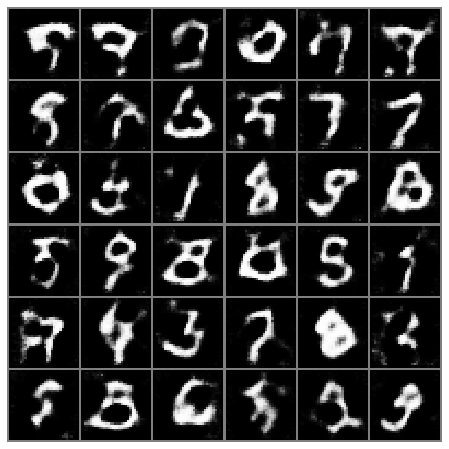

Epoch [2 / 20] G loss: 0.9276443123817444 D loss: 0.9913186430931091


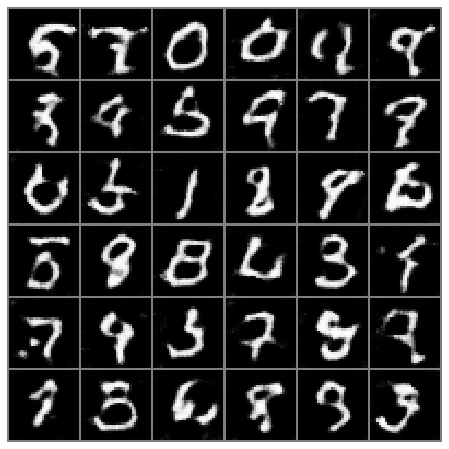

Epoch [3 / 20] G loss: 0.8364536166191101 D loss: 1.172407865524292


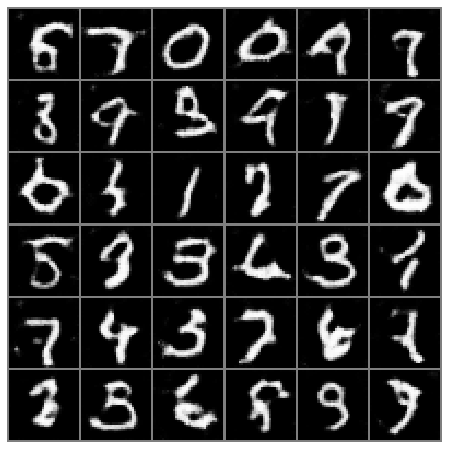

Epoch [4 / 20] G loss: 1.2585307359695435 D loss: 0.943966269493103


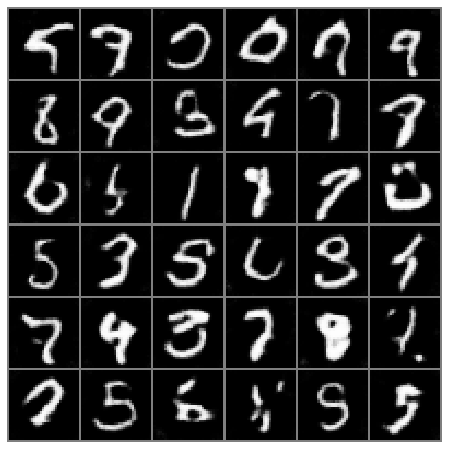

Epoch [5 / 20] G loss: 1.1266423463821411 D loss: 1.0864684581756592


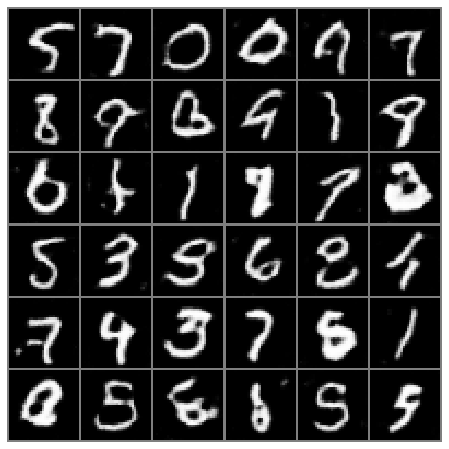

Epoch [6 / 20] G loss: 2.911139726638794 D loss: 0.17243248224258423


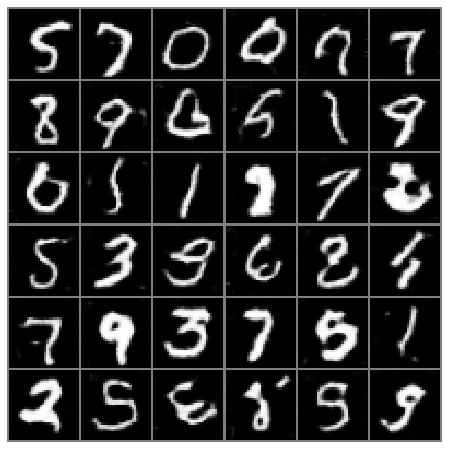

Epoch [7 / 20] G loss: 2.499215602874756 D loss: 0.16903282701969147


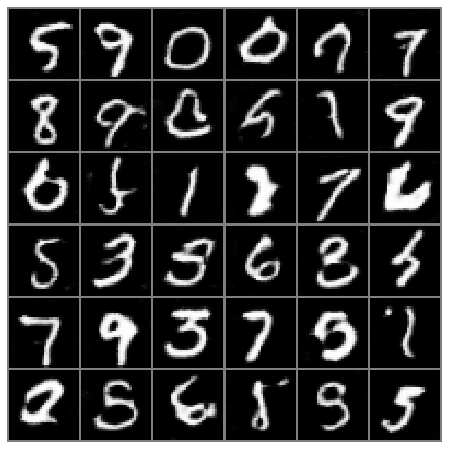

Epoch [8 / 20] G loss: 3.1765031814575195 D loss: 0.07197067886590958


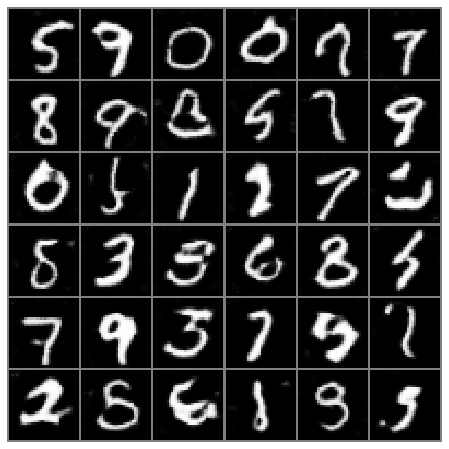

Epoch [9 / 20] G loss: 2.7515687942504883 D loss: 0.19951076805591583


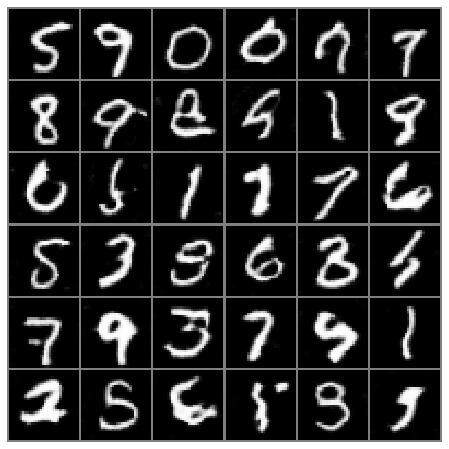

Epoch [10 / 20] G loss: 3.883863687515259 D loss: 0.044405944645404816


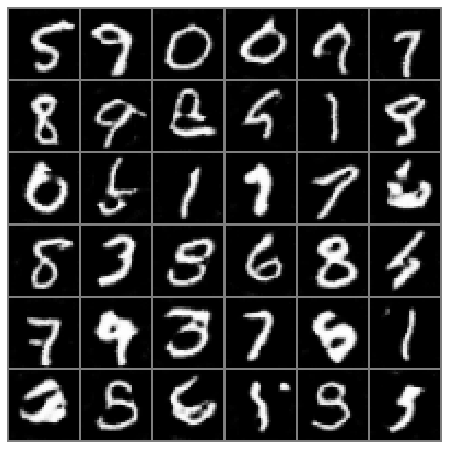

Epoch [11 / 20] G loss: 3.900753974914551 D loss: 0.03886042535305023


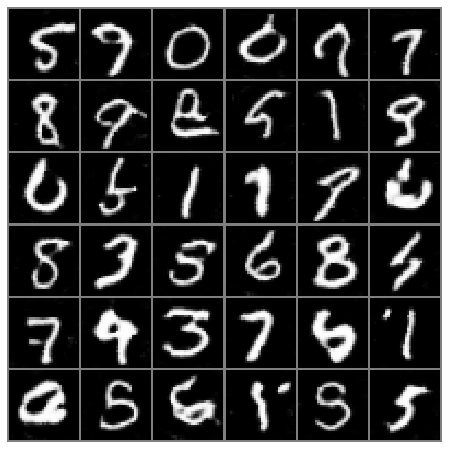

Epoch [12 / 20] G loss: 2.7210257053375244 D loss: 0.5709889531135559


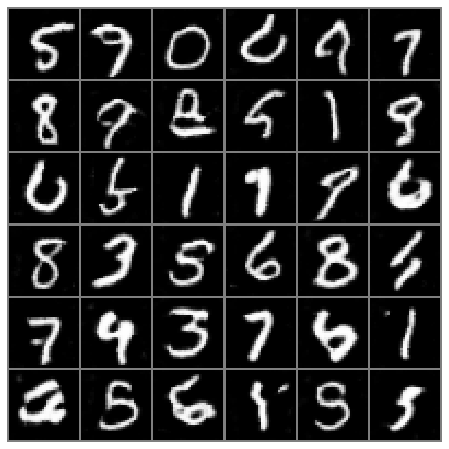

Epoch [13 / 20] G loss: 3.555335283279419 D loss: 0.0630144476890564


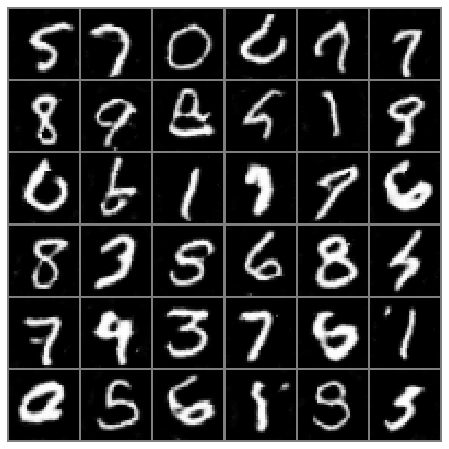

Epoch [14 / 20] G loss: 4.063289165496826 D loss: 0.03240063041448593


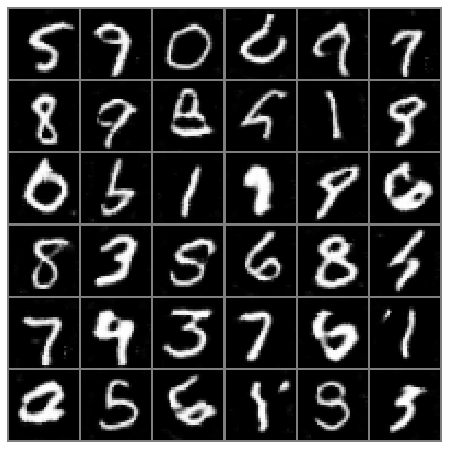

Epoch [15 / 20] G loss: 2.1770341396331787 D loss: 0.1094718724489212


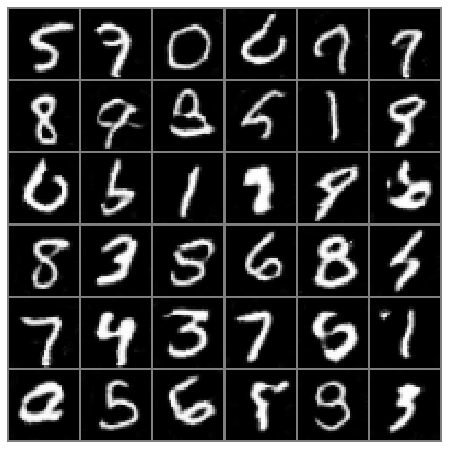

Epoch [16 / 20] G loss: 2.633451223373413 D loss: 0.14126013219356537


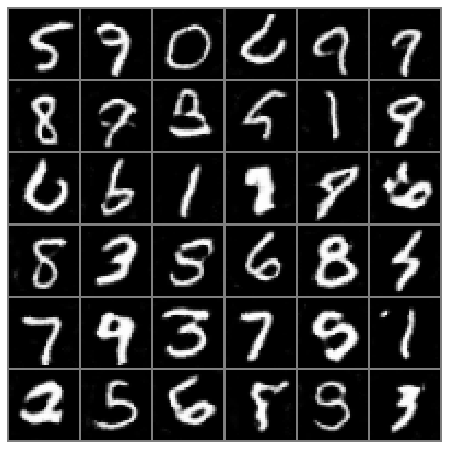

Epoch [17 / 20] G loss: 0.9460641741752625 D loss: 1.4477553367614746


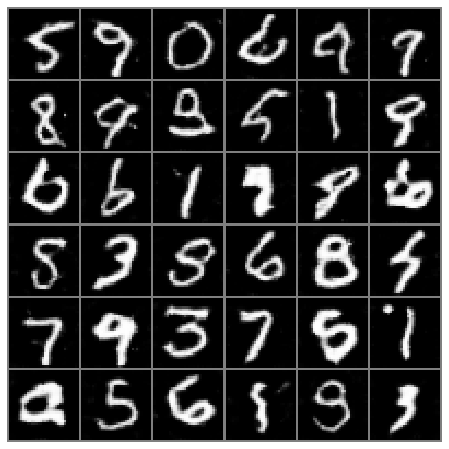

Epoch [18 / 20] G loss: 1.430254578590393 D loss: 0.7126362323760986


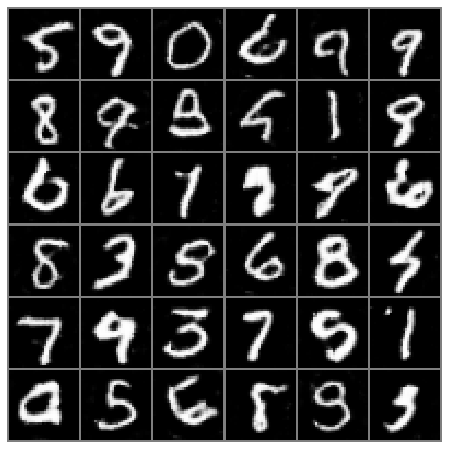

Epoch [19 / 20] G loss: 2.4510576725006104 D loss: 0.17402735352516174


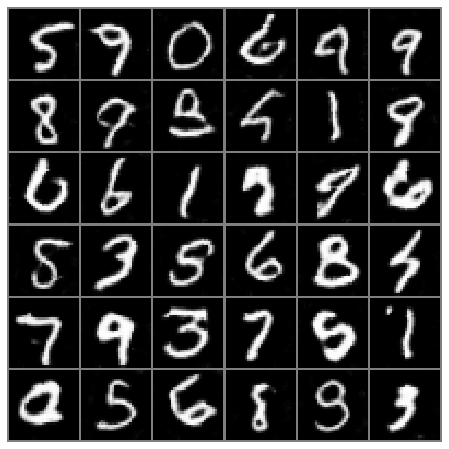

Epoch [20 / 20] G loss: 4.449957370758057 D loss: 0.018070444464683533


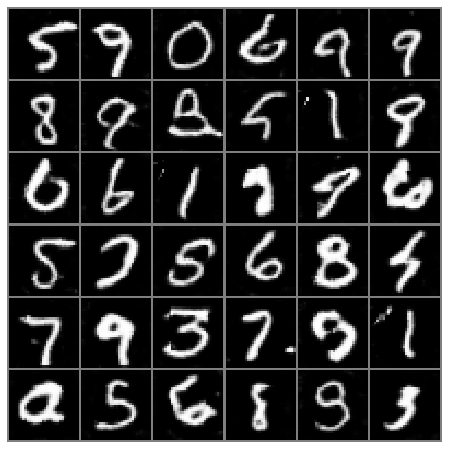

Avg per epoch time: 556.60 sec, total 20 epochs time: 185.67 min
Training finished!
...saving training results


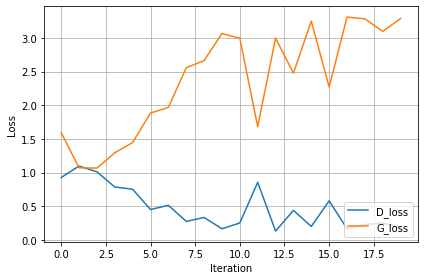

In [15]:
data_loader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True)

dset_name = 'mnist' #pick a meaningful name
result_dir = '{}_DCGAN'.format(dset_name)

device = torch.device("cuda:0")


#######################################################################################################
# TODO 5a: Fill code for training setup
#######################################################################################################

# define networks
G = Generator
G.apply(weight_init)
D = Discriminator
D.apply(weight_init)

# define optimizers
G_optimizer = optim.Adam(G.parameters(), lr=lr, betas=(0.5, 0.999))
D_optimizer = optim.Adam(D.parameters(), lr=lr, betas=(0.5, 0.999)) 

# results save folder
if not os.path.isdir(result_dir):
    os.mkdir(result_dir)
if not os.path.isdir(result_dir+'/Random'):
    os.mkdir(result_dir+'/Random')
if not os.path.isdir(result_dir+'/Fixed'):
    os.mkdir(result_dir+'/Fixed')

progress = {}
progress['D_losses'] = []
progress['G_losses'] = []
progress['per_epoch_times'] = []
progress['total_time'] = []
num_iter = 0

# start training loop
print('Training ...')
start_time = time.time()
for epoch in range(num_epochs):
    
    D_losses = []
    G_losses = []
    
    epoch_start_time = time.time()
    for real, _ in data_loader:
        real = real.to(device)
        batch_size = real.size(0)
        
        #######################################################################################################
        # TODO 5b: Fill code for training loop
        #######################################################################################################
        
        # generate random latent vector z and real and fake labels 
    
        z = torch.randn(batch_size, 100, 1, 1, device=device)
        real_label = torch.full((batch_size, ), 1, device=device)
        fake_label = torch.full((batch_size, ), 0, device=device)
        
        # generate fakes    
        fake = G(z) 
        
        # evaluate fakes
        # fake as a leaf node(image)
        pred_fake = D(fake.detach()).view(-1) 
        loss_fake = F.binary_cross_entropy(pred_fake, fake_label, reduction='mean')

        # evaluate real minibatch
        pred_real = D(real).view(-1)
        loss_real = F.binary_cross_entropy(pred_real, real_label, reduction='mean')
        
        # accumulate discriminator loss from the information about the real and fake images it just saw
        D_train_loss = loss_fake + loss_real

        # train discriminator D step
        D.zero_grad()
        # calculate the gradient
        D_train_loss.backward()
        # accumulate the gradient to the corresponding variables
        D_optimizer.step()    
        
        # train generator to output an image that is classified as real
        G_train_loss = F.binary_cross_entropy(D(fake).view(-1), real_label, reduction='mean')  
        
        # train generator G step
        G.zero_grad()
        G_train_loss.backward()
        G_optimizer.step()              

        D_losses.append(D_train_loss.data.item())
        G_losses.append(G_train_loss.data.item())

        num_iter += 1

    epoch_end_time = time.time()
    per_epoch_time = epoch_end_time - epoch_start_time
    
    print('Epoch [{} / {}] G loss: {} D loss: {}'.format(epoch + 1, num_epochs, G_train_loss, D_train_loss))

    show_result( epoch, save=True, path=result_dir + '/Random/{}_DCGAN_{}.png'.format(dset_name, epoch), useFixed=False )
    show_result( epoch, save=True, show=True, path=result_dir + '/Fixed/{}_DCGAN_{}.png'.format(dset_name, epoch), useFixed=True )
    progress['D_losses'].append(torch.mean(torch.FloatTensor(D_losses)))
    progress['G_losses'].append(torch.mean(torch.FloatTensor(G_losses)))
    progress['per_epoch_times'].append(per_epoch_time)

end_time = time.time()
total_time = end_time - start_time
progress['total_time'].append(total_time)

print('Avg per epoch time: {:.2f} sec, total {:d} epochs time: {:.2f} min'.format(torch.mean(torch.FloatTensor(progress['per_epoch_times'])), num_epochs, total_time / 60))
print('Training finished!')
print('...saving training results')

torch.save(G.state_dict(), result_dir + '/generator_network.pkl')
torch.save(D.state_dict(), result_dir + '/discriminator_network.pkl')
with open(result_dir + '/progress.pkl', 'wb') as f:
    pickle.dump(progress, f)

# plot the loss curves    
plot_losses(progress, save=True, path=result_dir + '/{}_DCGAN_progress.png'.format(dset_name))

# Visualize the training progress as an animated GIF
images = []
for e in range(num_epochs):
    img_name = result_dir + '/Fixed/{}_DCGAN_{}.png'.format(dset_name, e)
    images.append(imageio.imread(img_name))
imageio.mimsave(result_dir + '/DCGAN_generation_animation.gif', images, fps=5)

### Display the animated generation GIF

% **TODO: edit path to GIF** %

<img src='mnist_DCGAN/DCGAN_generation_animation.gif' width="512">

### 6) Explore the latent space of the generator (5 points)
We now want to **explore the expressiveness** of the Generator. Intuitively, a small change in values of the latent vector $z$ should result in a small change in the output image, and a linear interpolation between two latent vectors $z_1$ and $z_2$ should yield a reasonably smooth transition from one valid output image to another. Implement a function that creates a grid of latent vectors, where each row is an interpolation from the leftmost to the rightmost latent vector, with $n$ interpolation steps.

The expected output of this function should look like this (or better): 


<img src="img/latent_space_morph_MNIST.PNG" width="900">
<img src="img/latent_space_morph_FashionMNIST.png" width="900">

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


torch.Size([5, 10, 100, 1, 1])


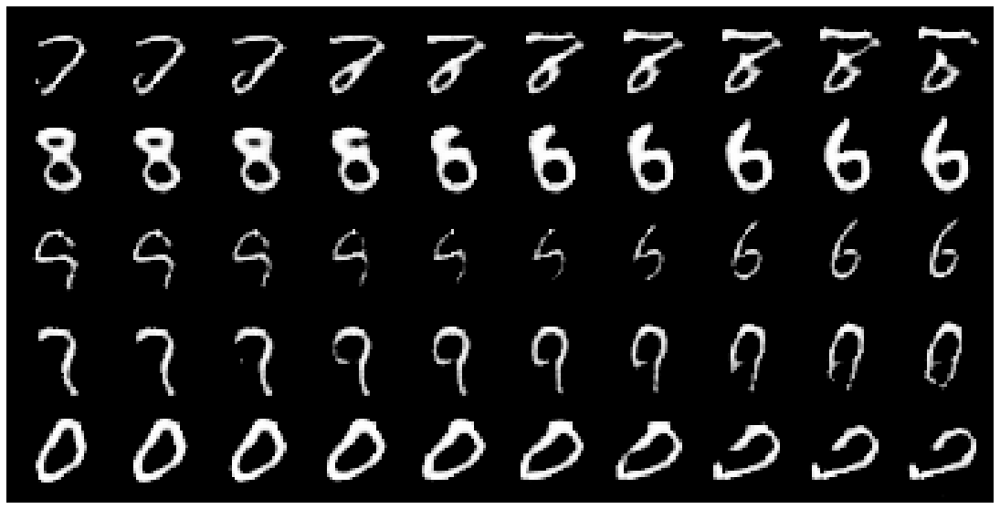

In [16]:
def generate_latent_interpolation(rows=5, interp_steps=10):
     with torch.no_grad():
        #######################################################################################################
        # TODO 6: for each row, create interpolation between leftmost and rightmost output image
        #######################################################################################################
        
        z1 = torch.randn(rows,100,1,1).to(device)
        z2 = torch.randn(rows,100,1,1).to(device)
        
        z= []
        for i in range(interp_steps):
            a = i/ (interp_steps - 1)
            z.append(a * z1 + (1 -a) * z2) 
        
        # 5 rows 10 columns
        z_stack = torch.stack(z).transpose(0,1)
        print(z_stack.shape)
        
        # memory
        z_stack = z_stack.contiguous().view(-1,100,1,1)
        grid_images = G(z_stack).cpu()
        
        fig, ax = plt.subplots(figsize=(20, 10))
        grid = utils.make_grid(grid_images, interp_steps)
        # channel positions of numoy and torch
        # grid 3 4 5    np 453
        plt.imshow(np.transpose(grid, (1, 2, 0)))
        ax.axis('off')

generate_latent_interpolation()        

### 7) Modify the network to output $64\times64$ RGB images (10 points)

Download `UTK_face.tar.gz` from [Google Drive](https://drive.google.com/drive/folders/0BxYys69jI14kU0I1YUQyY1ZDRUE) and extract the images to your working directory in the folder `./data/UTKFace/train`. This dataset [4] contains approximately 24K cropped images of human faces of mixed age, gender and race.

Load these images and resize them to the dimensions you want to generate ($64\times64$ RGB images). Replicate and modify your Generator and Discriminator network architectures in order to output the appropriate image size and three color channels. You may want to consult the [original DCGAN paper](https://arxiv.org/abs/1511.06434) to check what their suggested architecture looks like. You should generate an output similar to this (or better):

<img src="img/DCGAN_faces.png" width="900">



You can either modify the code above, or copy the necessary code pieces, but **make sure you include all results** of different datasets in your final report or in this notebook.

In [17]:
pwd

'/home/qus/Documents/CS390_Sally/Project 4'

In [32]:
#######################################################################################################
# TODO 7: resize the images such that they have the shape of 3x64x64
#######################################################################################################
transform_utk = transforms.Compose([
            transforms.Resize(64),
            transforms.RandomHorizontalFlip(),
            transforms.ToTensor(),
            transforms.Normalize((0.5,0.5,0.5),(0.5,0.5,0.5))
        ])


train_dataset_utk = torchvision.datasets.ImageFolder(root = "data/", transform=transform_utk)

print("Dataset length: ", len(train_dataset_utk))
print("Image size: {}".format(train_dataset_utk[0][0].size()))
print("value range: [ {} - {} ]".format(torch.min(train_dataset_utk[0][0]), torch.max(train_dataset_utk[0][0])))

Dataset length:  23708
Image size: torch.Size([3, 64, 64])
value range: [ -0.9607843160629272 - 0.9921568632125854 ]


In [33]:
#######################################################################################################
# TODO 7: train a DCGAN on the face images
#######################################################################################################
class Generator2(nn.Module):
    def __init__(self):
        super(Generator2, self).__init__()

        # Input is the latent vector Z.100
        self.tconv1 = nn.ConvTranspose2d(100, 512,
            kernel_size=4, bias=False)
        self.bn1 = nn.BatchNorm2d(512)
        self.relu1 = nn.ReLU(True)

        # Input Dimension: 512*4*4
        self.tconv2 = nn.ConvTranspose2d(512, 256,
            4, 2, 1, bias=False)
        self.bn2 = nn.BatchNorm2d(256)
        self.relu2 = nn.ReLU(True)

        # Input Dimension: 256 x 8 x 8
        self.tconv3 = nn.ConvTranspose2d(256, 128,
            4, 2, 1, bias=False)
        self.bn3 = nn.BatchNorm2d(128)
        self.relu3 = nn.ReLU(True)

        # Input Dimension: 128 x 16 x 16
        self.tconv4 = nn.ConvTranspose2d(128, 64,
            4, 2, 1, bias=False)
        self.bn4 = nn.BatchNorm2d(64)
        self.relu4 = nn.ReLU(True)
        
        # Input Dimension: 64 x 32 x 32
        self.tconv5 = nn.ConvTranspose2d(64, 3,
            4, 2, 1, bias=False)

    def forward(self, x):
        x = self.relu1(self.bn1(self.tconv1(x)))
        x = self.relu2(self.bn2(self.tconv2(x)))
        x = self.relu3(self.bn3(self.tconv3(x)))
        x = self.relu4(self.bn4(self.tconv4(x)))

        x = F.tanh(self.tconv5(x))

        return x

    
class Discriminator2(nn.Module):
    def __init__(self):
        super(Discriminator2, self).__init__()
        
        # Input Dimension: 3 x 64 x 64
        # torch.nn.Conv2d(in_channels, out_channels, kernel_size, 
        #          stride=1, padding=0, dilation=1, groups=1, bias=True, padding_mode='zeros')
        self.conv1 = nn.Conv2d(3, 64,
            kernel_size = 4, stride = 2, padding = 1, bias=False)
        self.leaky_relu1 = nn.LeakyReLU(0.2, True)
        
        # Input Dimension: 64*32*32
        # torch.nn.BatchNorm2d(num_features, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv2 = nn.Conv2d(64,128,
            4, 2, 1, bias=False)
        self.bn2 = nn.BatchNorm2d(128)
        self.leaky_relu2 = nn.LeakyReLU(0.2, True)

        # Input Dimension: 128*16*16
        self.conv3 = nn.Conv2d(128, 256,
            4, 2, 1, bias=False)
        self.bn3 = nn.BatchNorm2d(256)
        self.leaky_relu3 = nn.LeakyReLU(0.2, True)

        # Input Dimension: 256*8*8
        self.conv4 = nn.Conv2d(256, 512,
            4, 2, 1, bias=False)
        self.bn4 = nn.BatchNorm2d(512)
        self.leaky_relu4 = nn.LeakyReLU(0.2, True)
      
        # Input Dimension: 512*4*4
        self.conv5 = nn.Conv2d(512, 1,
            4, 1, bias=False)
        self.leaky_relu5 = nn.LeakyReLU(0.2, True)
 
    # forward method
    def forward(self, input):
        x = self.leaky_relu1(self.conv1(input))
        x = self.leaky_relu2(self.bn2(self.conv2(x)))
        x = self.leaky_relu3(self.bn3(self.conv3(x)))
        x = self.leaky_relu4(self.bn4(self.conv4(x)))
        x = self.leaky_relu5(self.conv5(x))

        x = torch.sigmoid(x)

        return x


In [34]:

summary(create_model_gpu(Discriminator2), input_size=(3, 64, 64))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 64, 32, 32]           3,072
         LeakyReLU-2           [-1, 64, 32, 32]               0
            Conv2d-3          [-1, 128, 16, 16]         131,072
       BatchNorm2d-4          [-1, 128, 16, 16]             256
         LeakyReLU-5          [-1, 128, 16, 16]               0
            Conv2d-6            [-1, 256, 8, 8]         524,288
       BatchNorm2d-7            [-1, 256, 8, 8]             512
         LeakyReLU-8            [-1, 256, 8, 8]               0
            Conv2d-9            [-1, 512, 4, 4]       2,097,152
      BatchNorm2d-10            [-1, 512, 4, 4]           1,024
        LeakyReLU-11            [-1, 512, 4, 4]               0
           Conv2d-12              [-1, 1, 1, 1]           8,192
        LeakyReLU-13              [-1, 1, 1, 1]               0
Total params: 2,765,568
Trainable param

In [35]:

summary(create_model_gpu(Generator2), input_size=(100, 1, 1))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
   ConvTranspose2d-1            [-1, 512, 4, 4]         819,200
       BatchNorm2d-2            [-1, 512, 4, 4]           1,024
              ReLU-3            [-1, 512, 4, 4]               0
   ConvTranspose2d-4            [-1, 256, 8, 8]       2,097,152
       BatchNorm2d-5            [-1, 256, 8, 8]             512
              ReLU-6            [-1, 256, 8, 8]               0
   ConvTranspose2d-7          [-1, 128, 16, 16]         524,288
       BatchNorm2d-8          [-1, 128, 16, 16]             256
              ReLU-9          [-1, 128, 16, 16]               0
  ConvTranspose2d-10           [-1, 64, 32, 32]         131,072
      BatchNorm2d-11           [-1, 64, 32, 32]             128
             ReLU-12           [-1, 64, 32, 32]               0
  ConvTranspose2d-13            [-1, 3, 64, 64]           3,072
Total params: 3,576,704
Trainable param

Ready to train.
Training ...
Epoch [1 / 40] G loss: 0.7273887395858765 D loss: 1.4302691221237183


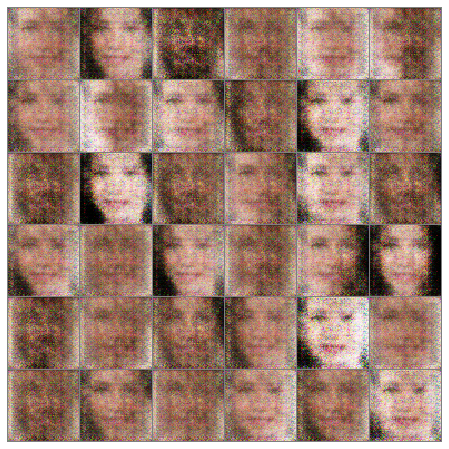

Epoch [2 / 40] G loss: 0.7083983421325684 D loss: 1.3998515605926514


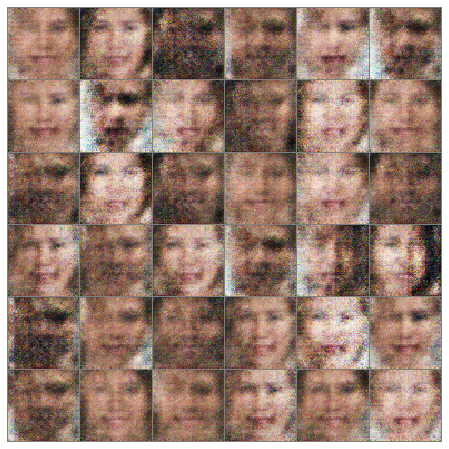

Epoch [3 / 40] G loss: 0.7546218633651733 D loss: 1.4063340425491333


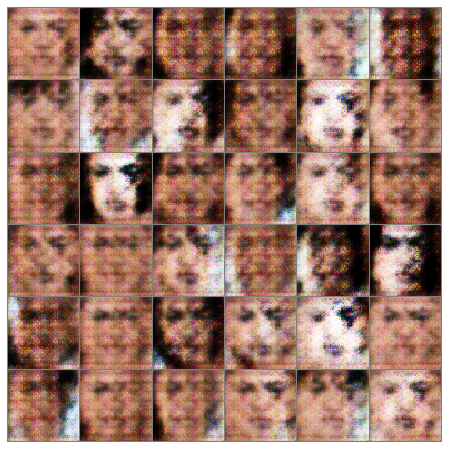

Epoch [4 / 40] G loss: 0.732525646686554 D loss: 1.3802342414855957


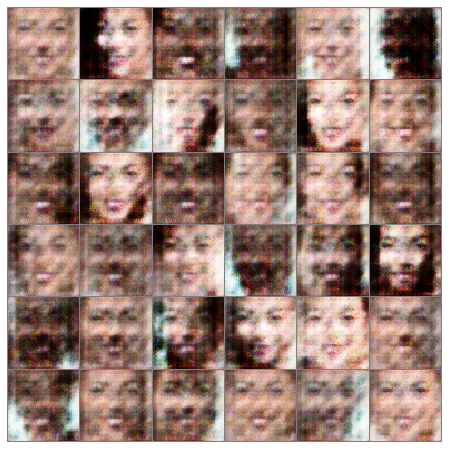

Epoch [5 / 40] G loss: 0.7165727019309998 D loss: 1.3764257431030273


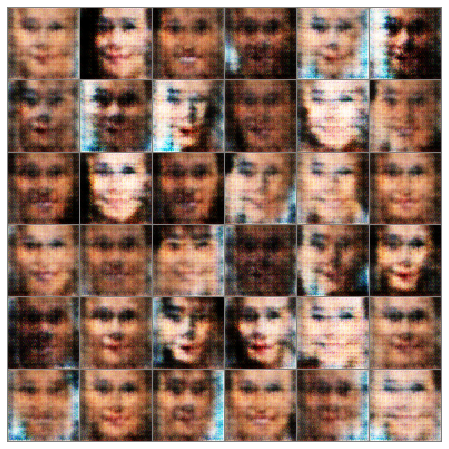

Epoch [6 / 40] G loss: 0.756890594959259 D loss: 1.39320969581604


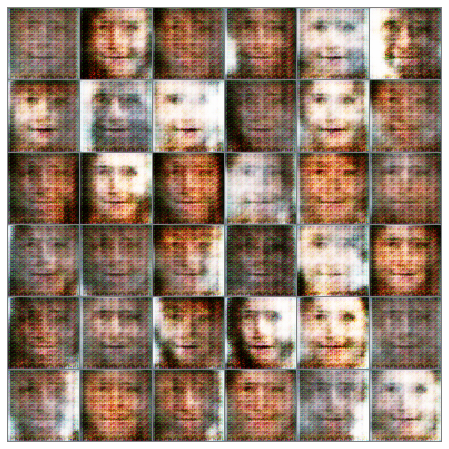

Epoch [7 / 40] G loss: 0.7283552885055542 D loss: 1.3876335620880127


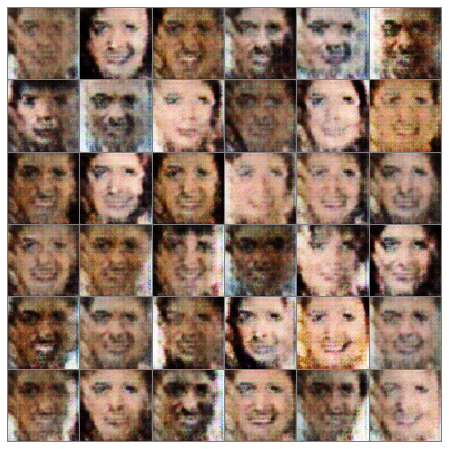

Epoch [8 / 40] G loss: 0.7221020460128784 D loss: 1.3945893049240112


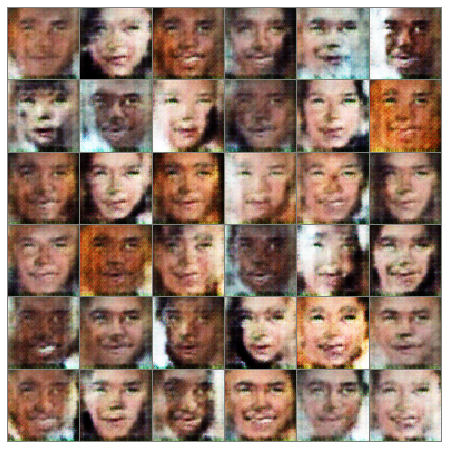

Epoch [9 / 40] G loss: 0.717639684677124 D loss: 1.385187029838562


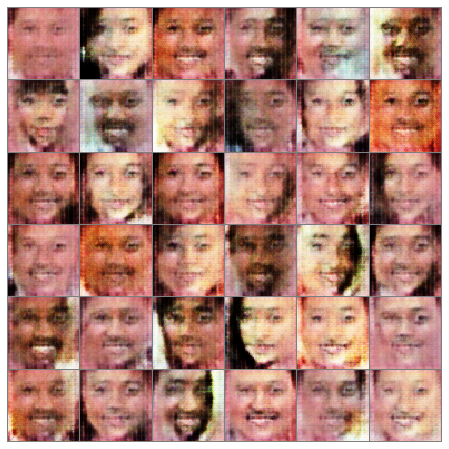

Epoch [10 / 40] G loss: 0.7170259952545166 D loss: 1.384682059288025


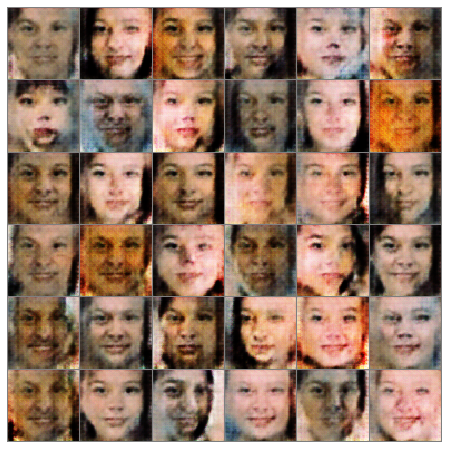

Epoch [11 / 40] G loss: 0.7265352010726929 D loss: 1.4167754650115967


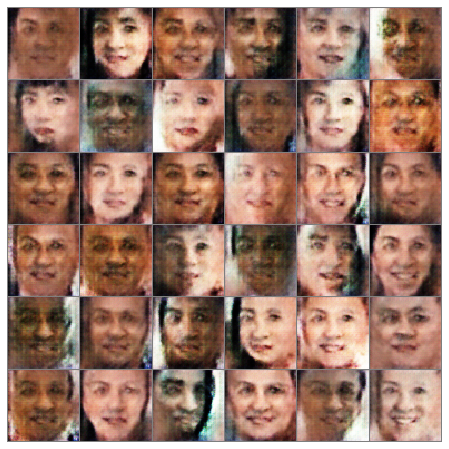

Epoch [12 / 40] G loss: 0.7314575910568237 D loss: 1.3822872638702393


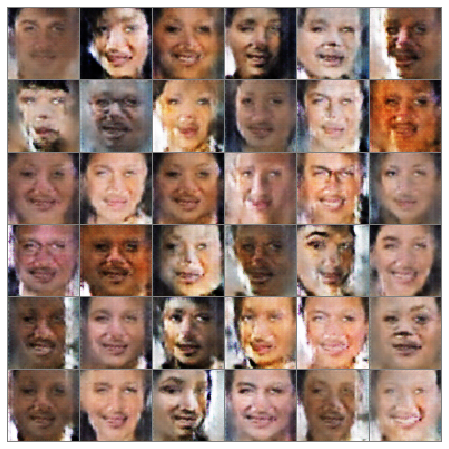

Epoch [13 / 40] G loss: 0.7307144403457642 D loss: 1.3909480571746826


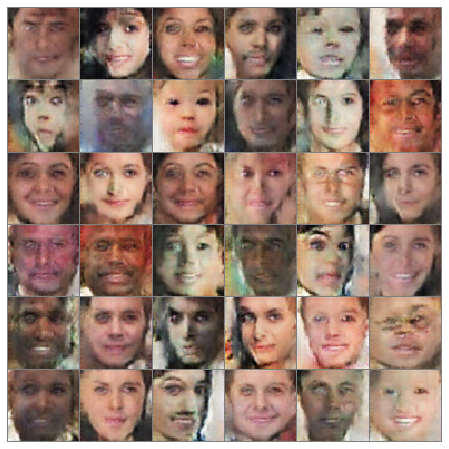

Epoch [14 / 40] G loss: 0.7051619291305542 D loss: 1.3806185722351074


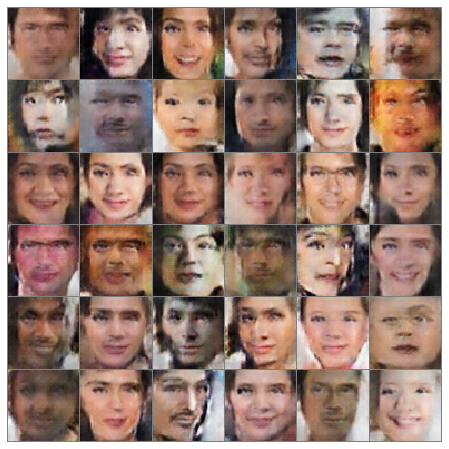

Epoch [15 / 40] G loss: 0.7374793291091919 D loss: 1.4053153991699219


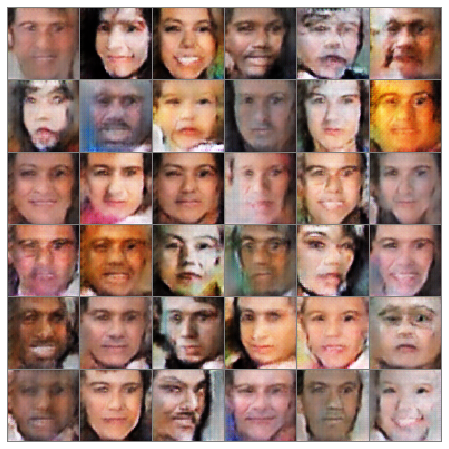

Epoch [16 / 40] G loss: 0.7236707210540771 D loss: 1.3826096057891846


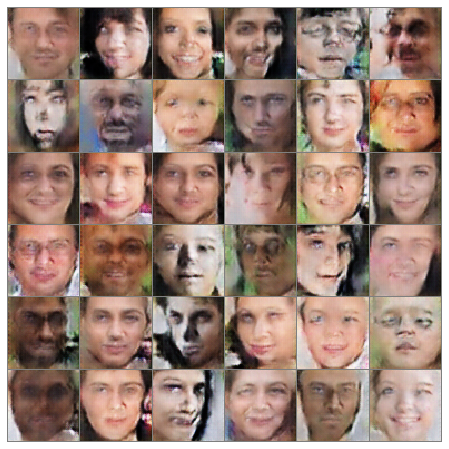

Epoch [17 / 40] G loss: 0.7572742104530334 D loss: 1.3939754962921143


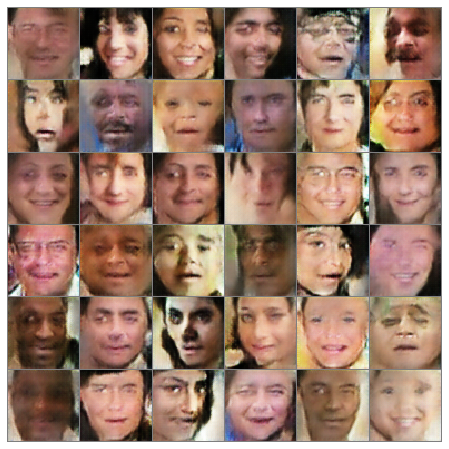

Epoch [18 / 40] G loss: 0.7633849382400513 D loss: 1.4187419414520264


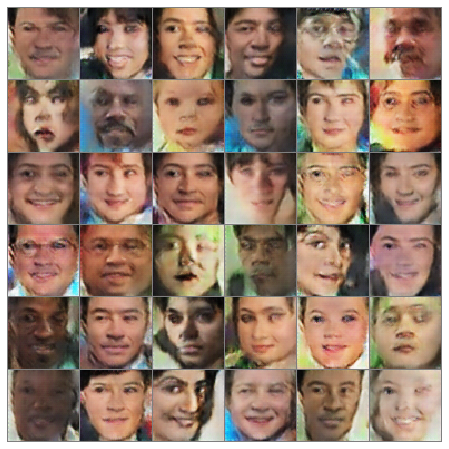

Epoch [19 / 40] G loss: 0.7498031854629517 D loss: 1.4378668069839478


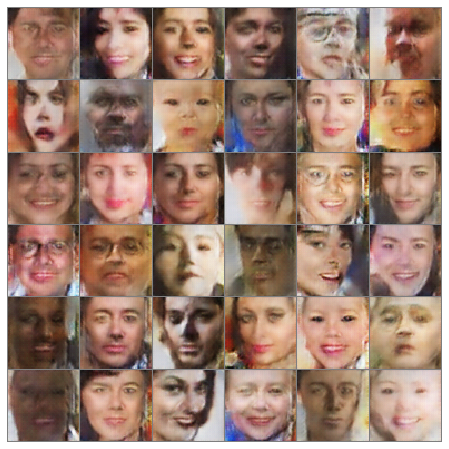

Epoch [20 / 40] G loss: 0.7294492721557617 D loss: 1.4114701747894287


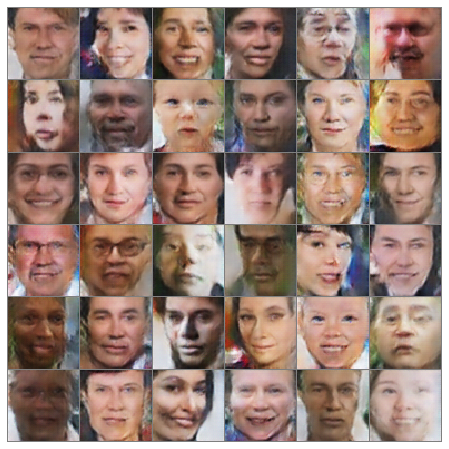

Epoch [21 / 40] G loss: 0.7880306243896484 D loss: 1.388965368270874


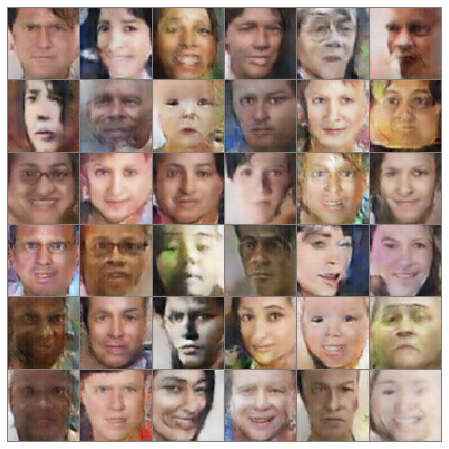

Epoch [22 / 40] G loss: 0.7558969259262085 D loss: 1.3673229217529297


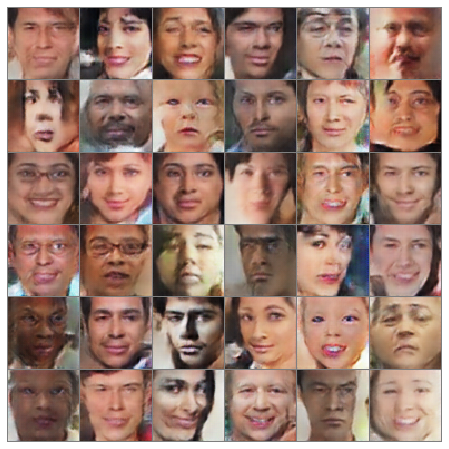

Epoch [23 / 40] G loss: 0.7408238649368286 D loss: 1.4085495471954346


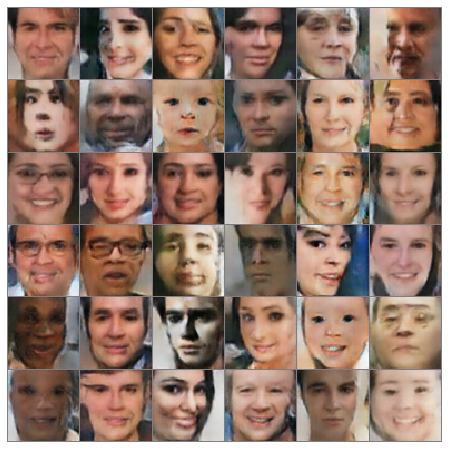

Epoch [24 / 40] G loss: 0.7306472659111023 D loss: 1.2657854557037354


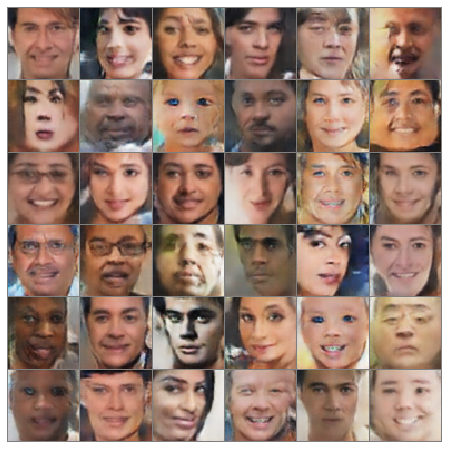

Epoch [25 / 40] G loss: 0.7368226051330566 D loss: 1.2829105854034424


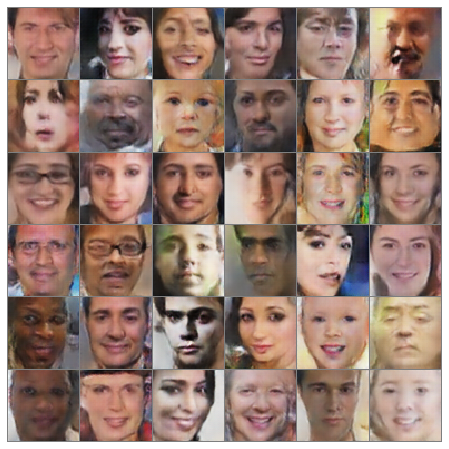

Epoch [26 / 40] G loss: 0.7160742282867432 D loss: 1.22141432762146


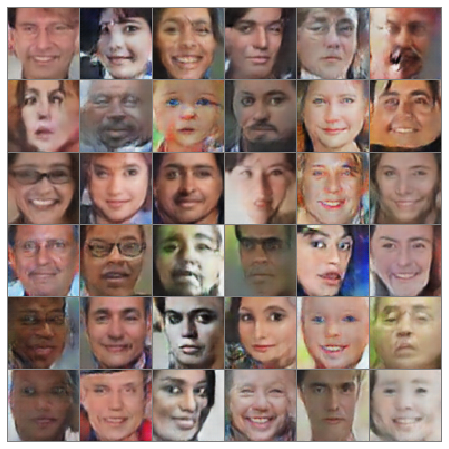

Epoch [27 / 40] G loss: 0.8037170171737671 D loss: 1.023017168045044


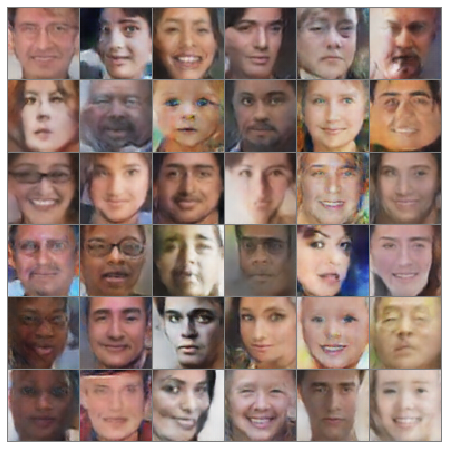

Epoch [28 / 40] G loss: 0.7688452005386353 D loss: 1.2071744203567505


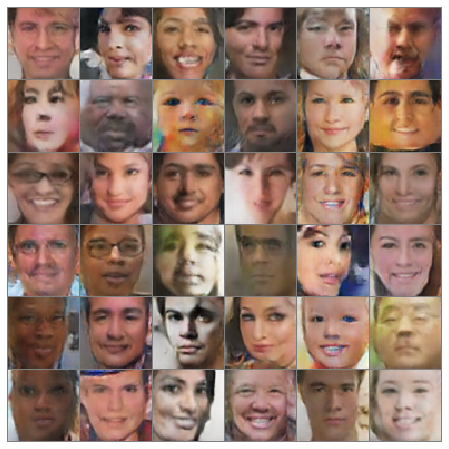

Epoch [29 / 40] G loss: 0.8444000482559204 D loss: 1.0299896001815796


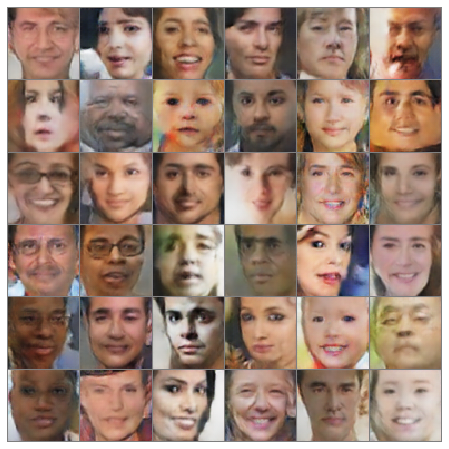

Epoch [30 / 40] G loss: 0.7891405820846558 D loss: 1.0863773822784424


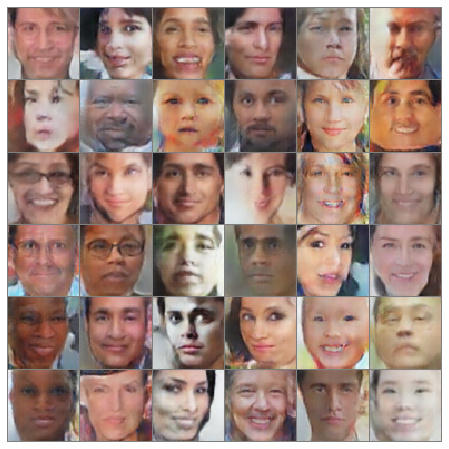

Epoch [31 / 40] G loss: 0.8017395734786987 D loss: 1.0265130996704102


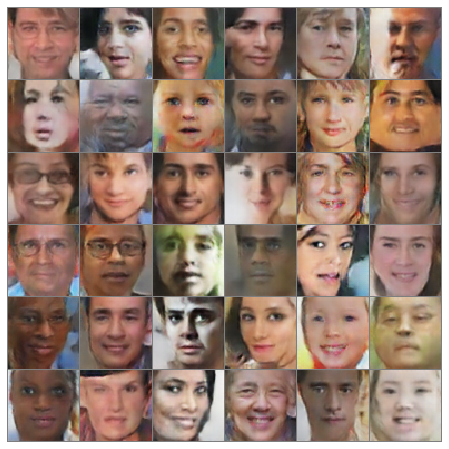

Epoch [32 / 40] G loss: 0.8267542123794556 D loss: 1.19887113571167


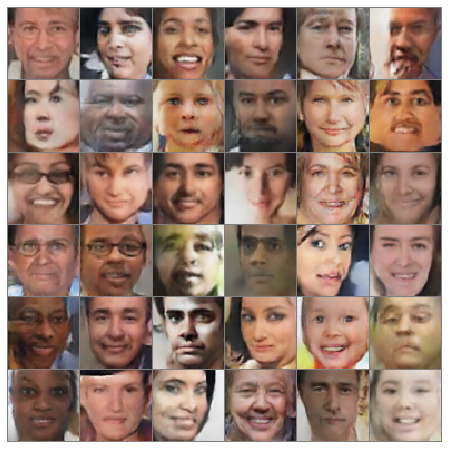

Epoch [33 / 40] G loss: 0.9229902029037476 D loss: 0.9809030294418335


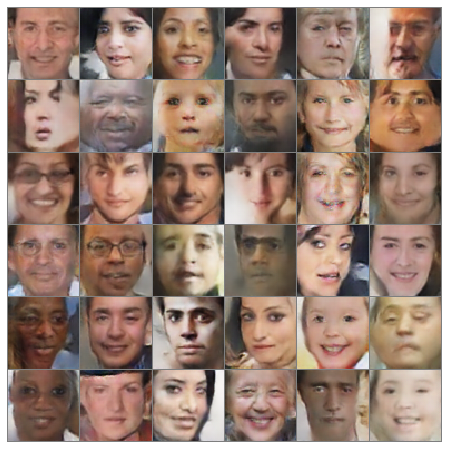

Epoch [34 / 40] G loss: 0.9100937843322754 D loss: 1.232731819152832


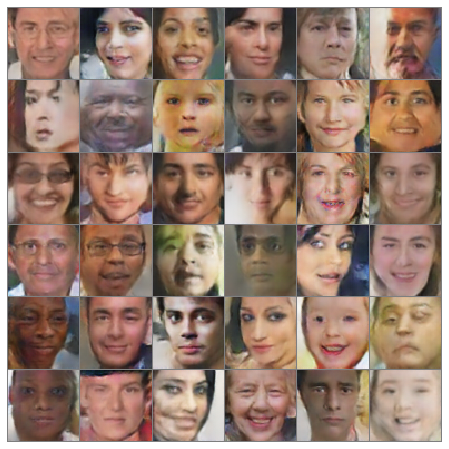

Epoch [35 / 40] G loss: 0.8748279809951782 D loss: 0.8493654131889343


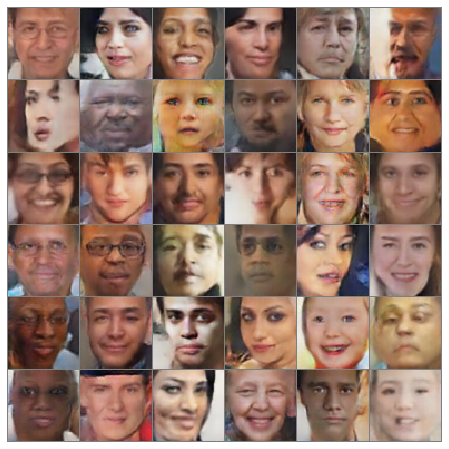

Epoch [36 / 40] G loss: 0.9545270204544067 D loss: 0.9561380743980408


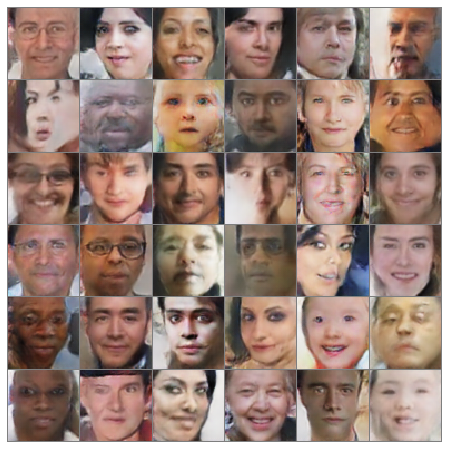

Epoch [37 / 40] G loss: 1.058891773223877 D loss: 0.7572493553161621


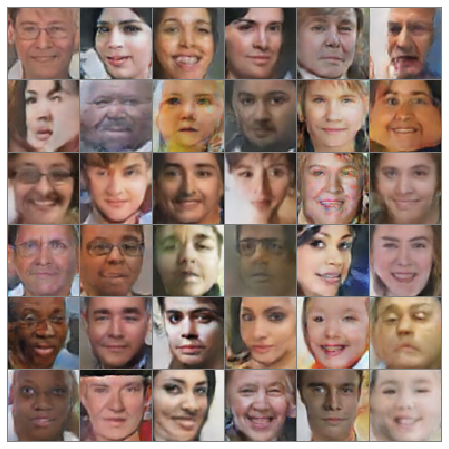

Epoch [38 / 40] G loss: 1.0306648015975952 D loss: 1.1285903453826904


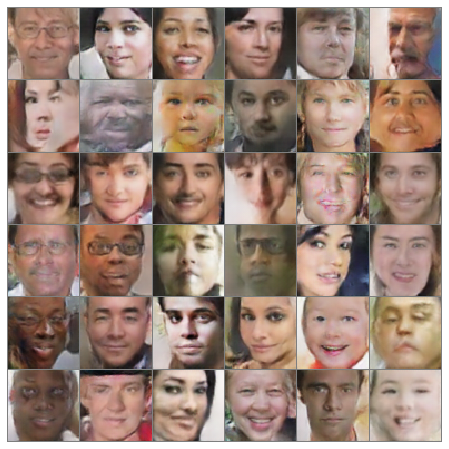

Epoch [39 / 40] G loss: 1.1577739715576172 D loss: 0.6983795166015625


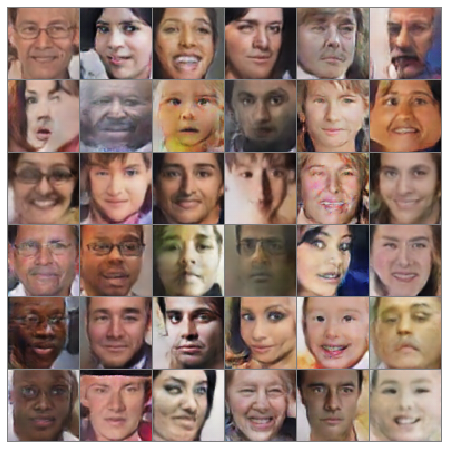

Epoch [40 / 40] G loss: 0.8615989685058594 D loss: 1.055368185043335


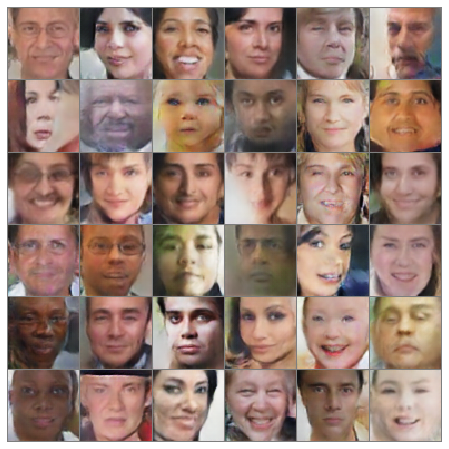

Avg per epoch time: 136.43 sec, total 40 epochs time: 91.36 min
Training finished!
...saving training results


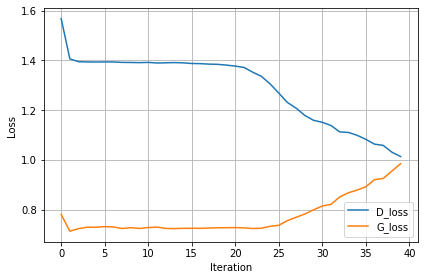

In [54]:
data_loader = torch.utils.data.DataLoader(train_dataset_utk, batch_size=batch_size, shuffle=True)

dset_name = 'utk_face' #pick a meaningful name
result_dir = '{}_DCGAN'.format(dset_name)

device = torch.device("cuda:0")
lr = 0.001
num_epochs = 40

# define networks
G = create_model_gpu(Generator2)
G.apply(weight_init)
D = create_model_gpu(Discriminator2)
D.apply(weight_init)

print('Ready to train.')

# define optimizers
G_optimizer = optim.Adam(G.parameters(), lr=lr, betas=(0.5, 0.999))
D_optimizer = optim.Adam(D.parameters(), lr=lr/20, betas=(0.5, 0.999)) 

# results save folder
if not os.path.isdir(result_dir):
    os.mkdir(result_dir)
if not os.path.isdir(result_dir+'/Random'):
    os.mkdir(result_dir+'/Random')
if not os.path.isdir(result_dir+'/Fixed'):
    os.mkdir(result_dir+'/Fixed')

progress = {}
progress['D_losses'] = []
progress['G_losses'] = []
progress['per_epoch_times'] = []
progress['total_time'] = []
num_iter = 0

# start training loop
print('Training ...')
start_time = time.time()
for epoch in range(num_epochs):
    
    D_losses = []
    G_losses = []
    
    epoch_start_time = time.time()
    for real, _ in data_loader:
        real = real.to(device)
        batch_size = real.size(0)
        
        #######################################################################################################
        # TODO 5b: Fill code for training loop
        #######################################################################################################
        
        # generate random latent vector z and real and fake labels 
    
        z = torch.randn(batch_size, 100, 1, 1, device=device)
        real_label = torch.full((batch_size, ), 1, device=device)
        fake_label = torch.full((batch_size, ), 0, device=device)
        
        # generate fakes    
        fake = G(z) 
        
        # evaluate fakes
        # fake as a leaf node(image)
        pred_fake = D(fake.detach()).view(-1) 
        loss_fake = F.binary_cross_entropy(pred_fake, fake_label, reduction='mean')

        # evaluate real minibatch
        pred_real = D(real).view(-1)
        loss_real = F.binary_cross_entropy(pred_real, real_label, reduction='mean')
        
        # accumulate discriminator loss from the information about the real and fake images it just saw
        D_train_loss = loss_fake + loss_real

        # train discriminator D step
        D.zero_grad()
        D_train_loss.backward()
        D_optimizer.step()    
        
        # train generator to output an image that is classified as real
        G_train_loss = F.binary_cross_entropy(D(fake).view(-1), real_label, reduction='mean')  
        
        # train generator G step
        G.zero_grad()
        G_train_loss.backward()
        G_optimizer.step()              

        D_losses.append(D_train_loss.data.item())
        G_losses.append(G_train_loss.data.item())

        num_iter += 1

    epoch_end_time = time.time()
    per_epoch_time = epoch_end_time - epoch_start_time
    
    print('Epoch [{} / {}] G loss: {} D loss: {}'.format(epoch + 1, num_epochs, G_train_loss, D_train_loss))

    show_result( epoch, save=True, path=result_dir + '/Random/{}_DCGAN_{}.png'.format(dset_name, epoch), useFixed=False )
    show_result( epoch, save=True, show=True, path=result_dir + '/Fixed/{}_DCGAN_{}.png'.format(dset_name, epoch), useFixed=True )
    progress['D_losses'].append(torch.mean(torch.FloatTensor(D_losses)))
    progress['G_losses'].append(torch.mean(torch.FloatTensor(G_losses)))
    progress['per_epoch_times'].append(per_epoch_time)

end_time = time.time()
total_time = end_time - start_time
progress['total_time'].append(total_time)

print('Avg per epoch time: {:.2f} sec, total {:d} epochs time: {:.2f} min'.format(torch.mean(torch.FloatTensor(progress['per_epoch_times'])), num_epochs, total_time / 60))
print('Training finished!')
print('...saving training results')

torch.save(G.state_dict(), result_dir + '/generator_network.pkl')
torch.save(D.state_dict(), result_dir + '/discriminator_network.pkl')
with open(result_dir + '/progress.pkl', 'wb') as f:
    pickle.dump(progress, f)

# plot the loss curves    
plot_losses(progress, save=True, path=result_dir + '/{}_DCGAN_progress.png'.format(dset_name))


### 8) Create a latent space walk of the Face Generator you trained (5 points)
To that end, generate as many random latents as your animation has number of frames. Then, use a gaussian filter on those latents in order to create a smooth blending between adjacent frames in the animation. Have a look at `scipy.ndimage.gaussian_filter` for that purpose. Make sure that your animation can loop endlessly, i.e. the last frames and the first frames of the animation also blend. The $\sigma$ value of the gaussian filter defines how many frames are blended; use the given parameter values of the function to control this value.<br>
Your output should look like this (or better):

<img src='img/Faces_DCGAN_latent_walk_1.gif' style='margin: 0px 10px' align='left' width="128">

<img src='img/Faces_DCGAN_latent_walk_2.gif' style='margin: 0px 10px' align='left' width="128">

<img src='img/Faces_DCGAN_latent_walk_3.gif' style='margin: 0px 10px' align='left' width="128">

In [84]:
from scipy.ndimage import gaussian_filter
def generate_latent_walk(duration_sec=20.0, smoothing_sec=1.0, fps=30):
    #######################################################################################################
    # TODO 8: create a smoothly interpolated loop through random latent space values
    #######################################################################################################
    # get the number of frames 
    n_frames = int(duration_sec * fps)        
    # generate latent vectors
    z = np.random.randn(n_frames, 100, 1, 1) 
    # gaussian filter, wrap to make the last frames and the first frames similar
    z = gaussian_filter(z, sigma=[smoothing_sec * fps,0,0,0] , mode='wrap')
    #z /= np.std(z)
    z_normalized = [z / np.std(z) for z in z]
    z = np.stack(z_normalized)
    z = torch.tensor(z).float().to(device)
    
    images = (0.5*(G(z).cpu().detach().numpy()+1)*255) # 0-1 > 0 -255
    images = np.uint8(images)
    images = list(images.transpose((0,2,3,1))) #create smoothly interpolating images
    #plt.imshow(images[20])
    imageio.mimsave(result_dir + '/latent_space_walk.gif', list(images), fps=fps)
    print('save to {}'.format(result_dir + '/latent_space_walk.gif'))

generate_latent_walk()   

save to utk_face_DCGAN/latent_space_walk.gif


In [80]:
duration_sec=20.0
smoothing_sec=1.0
fps=30
n_frames = int(duration_sec * fps)        
if 1:
    # generate latent vectors
    z = np.random.randn(n_frames, 100, 1, 1) #*10
    # gaussian filter, wrap to make the last frames and the first frames similar
    z = gaussian_filter(z, sigma=[smoothing_sec * fps] + [0] * len() , mode='wrap')
    # z /= np.std(z)
    #z_normalized = [z / np.std(z) for z in z]
    #z = np.stack(z_normalized)
    z = torch.tensor(z).float().to(device)
    
    images = (0.5*(G(z).cpu().detach().numpy()+1)*255) # 0-1 > 0 -255
    images = np.uint8(images)
    images = list(images.transpose((0,2,3,1))) #create smoothly interpolating images
    imageio.mimsave(result_dir + '/latent_space_walk.gif', list(images), fps=fps)
    print('save to {}'.format(result_dir + '/latent_space_walk.gif'))

save to utk_face_DCGAN/latent_space_walk.gif


### Display the animated generation GIF


<img src='utk_face_DCGAN/latent_space_walk.gif'  width="128" >

## Assignment 4B: Conditional DCGAN

Our previous Generator network was generating random outputs for each input latent vector without any measure of control over the output. 
Now, we would like to add some control mechanism such that we can determine the class for a generated image, e.g. generate only the number $5$ or images from the category $Shirt$.

The expected output of this GAN should look like this (or better):

<img src="img/cond_DCGAN_MNIST.png" align='left' width="550">
<img src="img/cond_DCGAN_fashionMNIST.png" align='left' width="550">

For simplicity, we will use either _MNIST_ or _FashionMNIST_ at $32\times32$ grayscale for this exercise again.

For a class-conditioned output, we need to modify both the generator as well as the discriminator network to accept a class label as part of the input. These labels need to be transformed from a "categorical" input to a numerical vector. Use `torch.nn.Embedding` to transform the label to such an embedding space.

### 8) Modify Networks for conditional GANs (4 points)

Select appropriate training hyperparameters.

In [24]:
# TODO: choose reasonable values
batch_size = 128
num_epochs = 20
learning_rate = 0.0002

### 9) Design a conditional discriminator network (8 points)

Below diagrams shows the architecture that you're expected to implement

<img src="img/DCGAN_Discriminator_conditional.png" align='left' width="900">

In [25]:
#######################################################################################################
#TODO 9: update the discriminator network to incorporate the label input
#######################################################################################################

class cDiscriminator(nn.Module):
    def __init__(self, n_classed = 10):
        super(cDiscriminator, self).__init__()
       
        # Input Dimension: 1 x 32 x 32
        # torch.nn.Conv2d(in_channels, out_channels, kernel_size, 
        #          stride=1, padding=0, dilation=1, groups=1, bias=True, padding_mode='zeros')
        self.conv1 = nn.Conv2d(1, 128,
            kernel_size = 4, stride = 2, padding = 1, bias=False)
        self.leaky_relu1 = nn.LeakyReLU(0.2, True)
        
        # Input Dimension: 128*16*16
        # torch.nn.BatchNorm2d(num_features, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        self.conv2 = nn.Conv2d(128,256,
            4, 2, 1, bias=False)
        self.bn2 = nn.BatchNorm2d(256)
        self.leaky_relu2 = nn.LeakyReLU(0.2, True)

        
        self.embedding = nn.Embedding(10, 50)
        self.linear = nn.Linear(50, 64)                
        
        
        # Input Dimension: 257*8*8
        self.conv3 = nn.Conv2d(257, 512,
            4, 2, 1, bias=False)
        self.bn3 = nn.BatchNorm2d(512)
        self.leaky_relu3 = nn.LeakyReLU(0.2, True)

        # Input Dimension: 512*4*4
        self.conv4 = nn.Conv2d(512, 1,
            4, 1, bias=False)
        
 
    # forward method
    def forward(self, input, labels):
        x = self.leaky_relu1(self.conv1(input))
        x = self.leaky_relu2(self.bn2(self.conv2(x)))
        x = torch.cat([x,self.linear(self.embedding(labels)).view(-1,1,8,8)], 1)
        x = self.leaky_relu3(self.bn3(self.conv3(x)))
        x = self.conv4(x)

        x = torch.sigmoid(x)

        return x

### 8) Design a conditional generator network (8 points)

<img src="img/DCGAN_Generator_conditional.png" align='left' width="900">

In [26]:
#######################################################################################################
#TODO 10: update the generator network to incorporate the label input
#######################################################################################################
    
class cGenerator(nn.Module):
    def __init__(self, n_classes=10):
        super(cGenerator, self).__init__()

        # Input is the latent vector Z.100
        self.tconv1 = nn.ConvTranspose2d(100, 512,
            kernel_size=4, bias=False)
        self.bn1 = nn.BatchNorm2d(512)
        self.relu1 = nn.ReLU(True)

        # Input Dimension: 512*4*4
        self.tconv2 = nn.ConvTranspose2d(512, 256,
            4, 2, 1, bias=False)
        self.bn2 = nn.BatchNorm2d(256)
        self.relu2 = nn.ReLU(True)

        self.embedding = nn.Embedding(n_classes, 50)
        self.linear = nn.Linear(50, 64)                

        # Input Dimension: 256 x 8 x 8
        self.tconv3 = nn.ConvTranspose2d(257, 128,
            4, 2, 1, bias=False)
        self.bn3 = nn.BatchNorm2d(128)
        self.relu3 = nn.ReLU(True)

        # Input Dimension: 128 x 16 x 16
        self.tconv4 = nn.ConvTranspose2d(128, 1,
            4, 2, 1, bias=False)


    def forward(self, x, labels):
        x = self.relu1(self.bn1(self.tconv1(x)))
        x = self.relu2(self.bn2(self.tconv2(x)))
        x = torch.cat([x,self.linear(self.embedding(labels)).view(-1,1,8,8)], 1)
        x = self.relu3(self.bn3(self.tconv3(x)))

        x = F.tanh(self.tconv4(x))

        return x

#### Complete the output function (5 points)

In [27]:
# output generated samples from the current state of the generator network
n_samples = 5

#######################################################################################################
# TODO 11: generate a fixed noise vector and a fixed set of labels to evaluate the output of the generator
# with the same noise parameters as training progresses.
# Arrange the labels into a grid to show same label outputs in the same column (see example results above) 
#######################################################################################################
fixed_z = torch.randn(n_samples*10, 100, 1, 1, device=device)
fixed_labels = torch.arange(10, device = device).repeat(n_samples)

def show_conditional_result(num_epoch, show=False, save=False, n_classes=10, n_samples=5, path='result.png', useFixed=False):
    with torch.no_grad():
        if useFixed:   
            fake = G(fixed_z, fixed_labels).cpu()
        else:
            # TODO generate a new random noise vector and a grid of labels
            z = torch.randn(n_samples*n_classes, 100, 1, 1, device=device)

            labels = torch.arange(10, device = device).repeat(n_samples)

            fake = G(z, labels).cpu()
       
        fake = (fake +1 )/2 # [0,1]
        fig, ax = plt.subplots(figsize=(20, 10))
        image = utils.make_grid(fake.data, n_classes, 1)

        plt.imshow(np.transpose(image, (1, 2, 0)))

        ax.axis('off')

        plt.savefig(path)

        if show:
            plt.show()
        else:
            plt.close()   

#### Complete the training setup (5 points) and training loop (10 points)

Training ...
Epoch [1 / 20] G loss: 9.244922637939453 D loss: 0.00020512944320216775


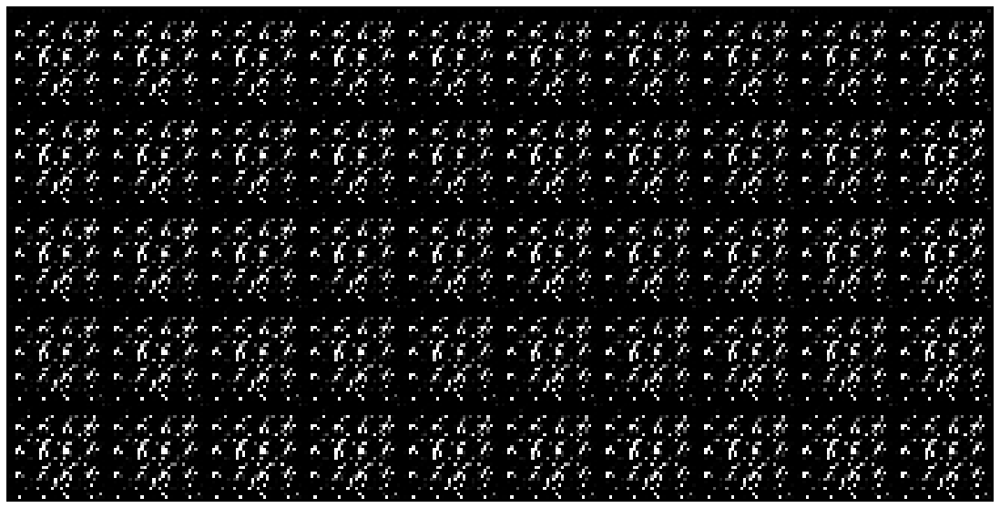

Epoch [2 / 20] G loss: 0.7481974959373474 D loss: 1.0759427547454834


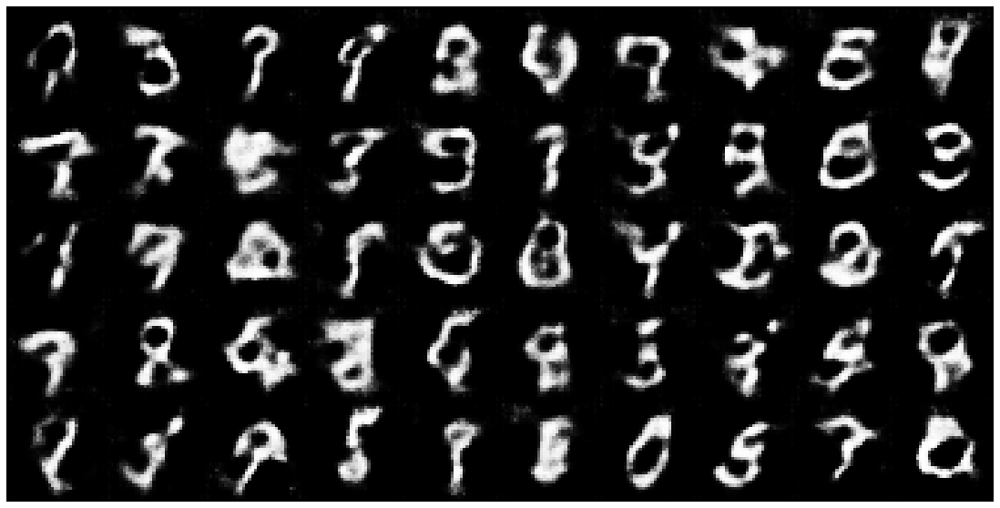

Epoch [3 / 20] G loss: 3.800546646118164 D loss: 0.15972739458084106


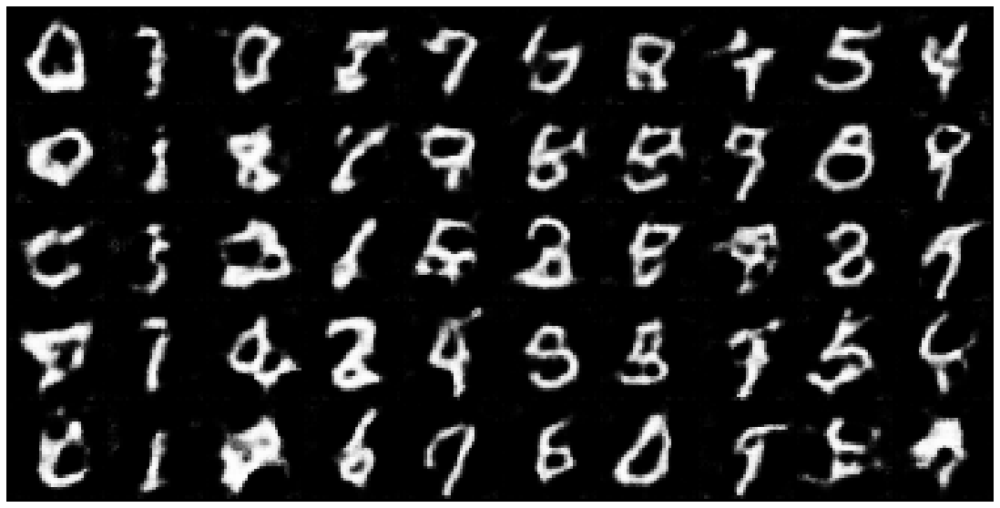

Epoch [4 / 20] G loss: 3.5569913387298584 D loss: 0.11661089956760406


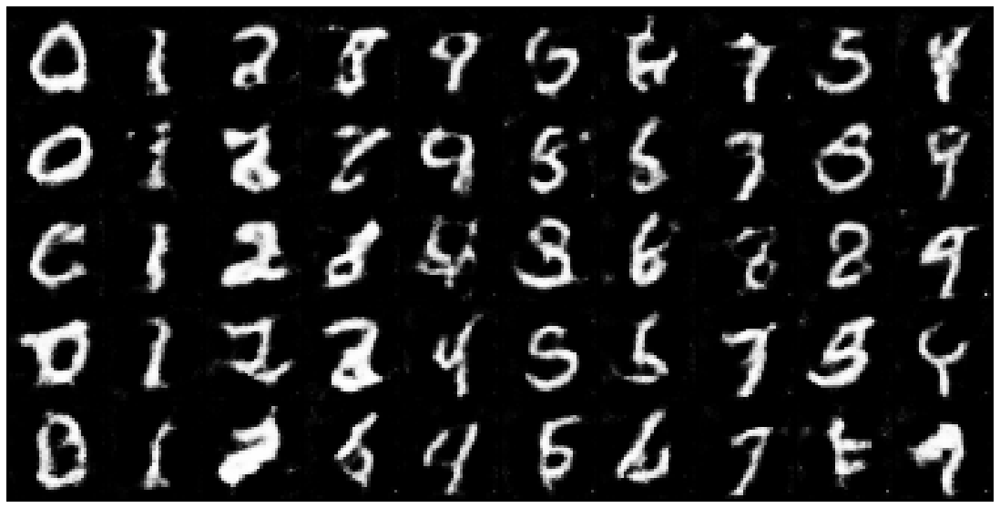

Epoch [5 / 20] G loss: 3.7664968967437744 D loss: 0.09437184035778046


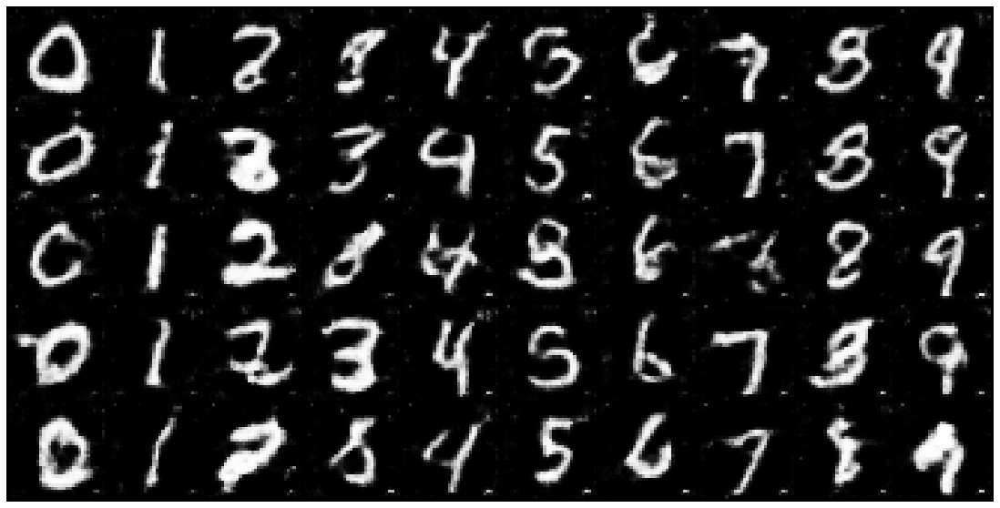

Epoch [6 / 20] G loss: 2.3308637142181396 D loss: 0.22726066410541534


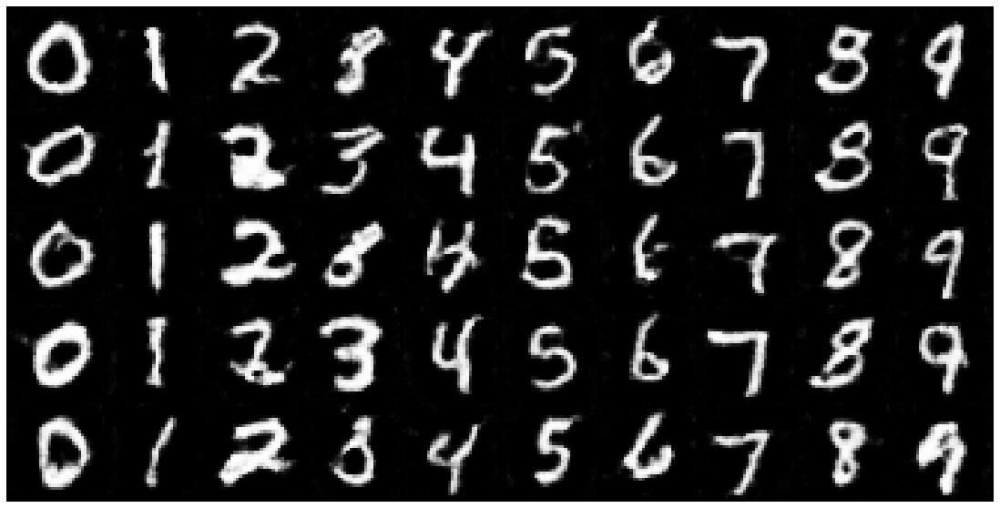

Epoch [7 / 20] G loss: 4.382568359375 D loss: 0.059004247188568115


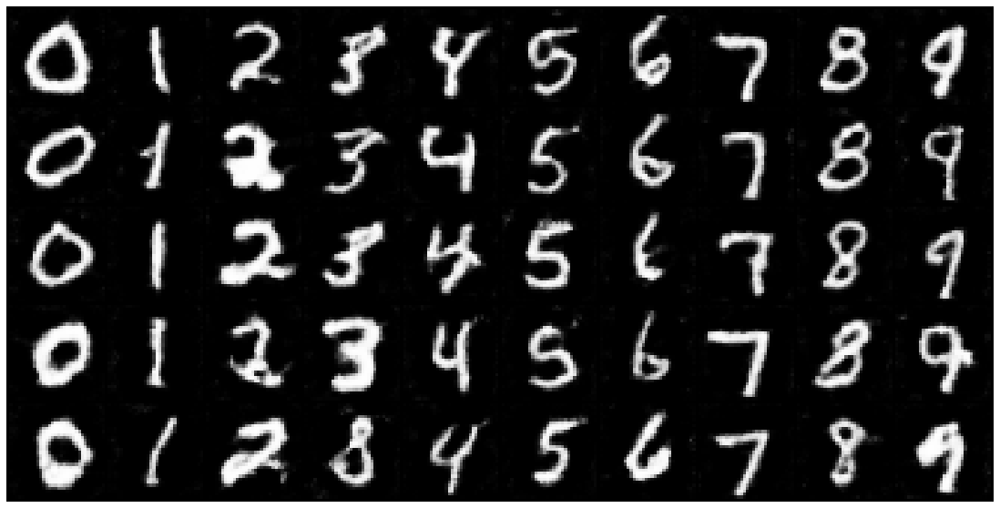

Epoch [8 / 20] G loss: 4.897227764129639 D loss: 0.05694630742073059


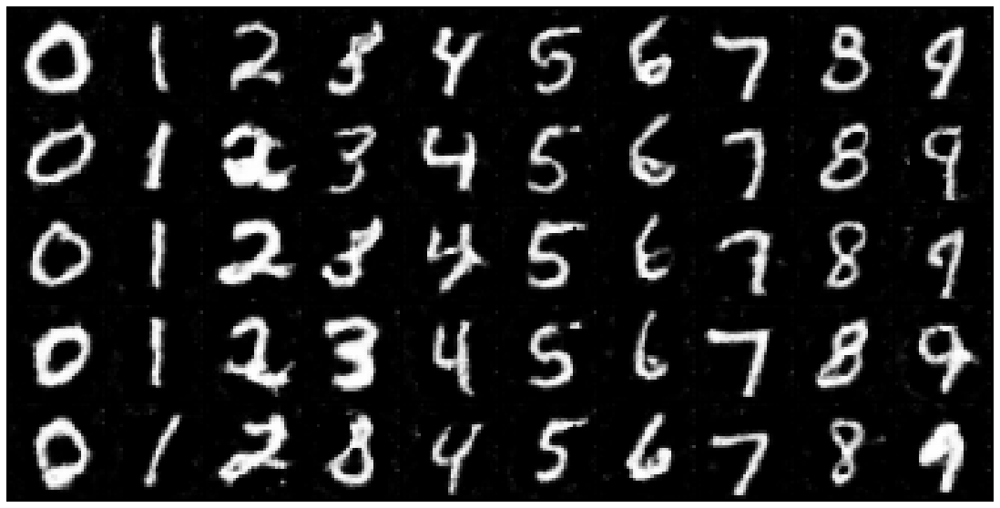

Epoch [9 / 20] G loss: 4.2913970947265625 D loss: 0.06452944874763489


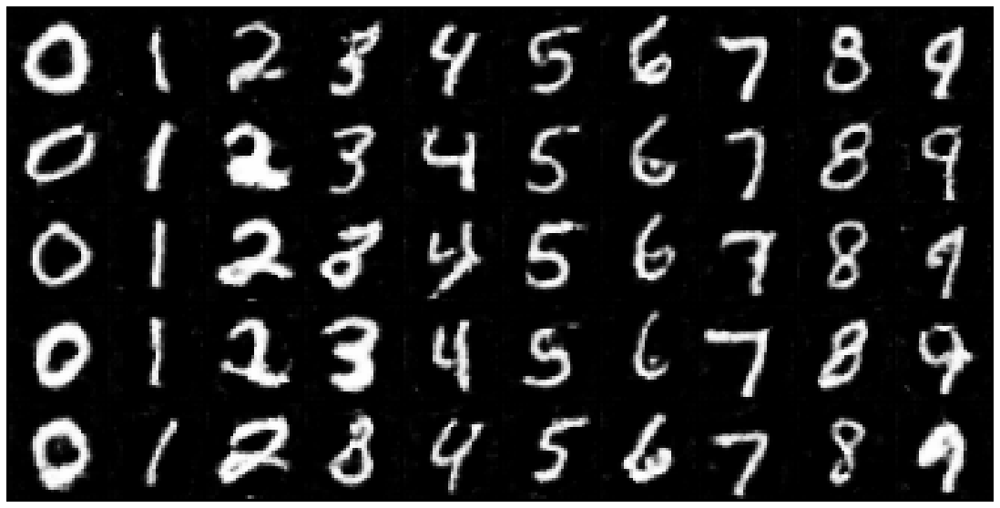

Epoch [10 / 20] G loss: 6.429605960845947 D loss: 0.020187627524137497


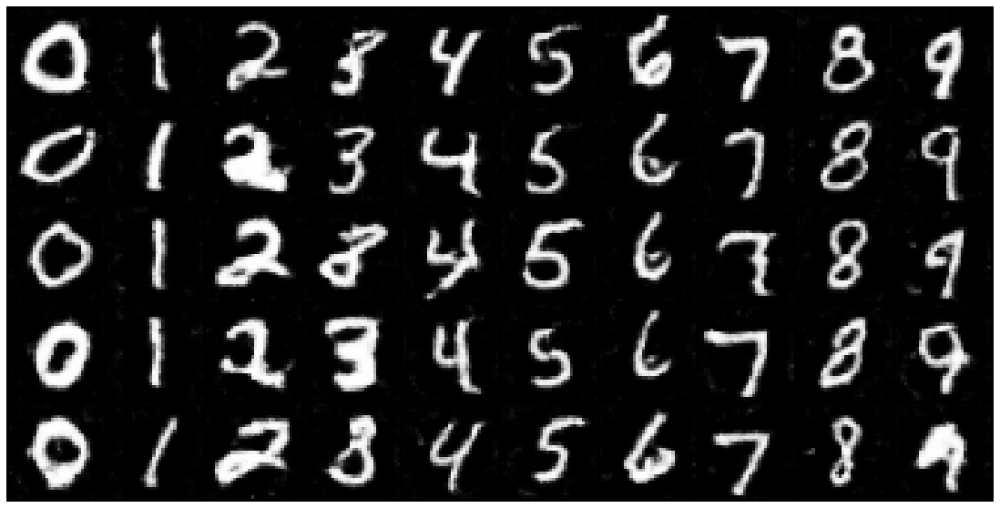

Epoch [11 / 20] G loss: 5.143228054046631 D loss: 0.030863109976053238


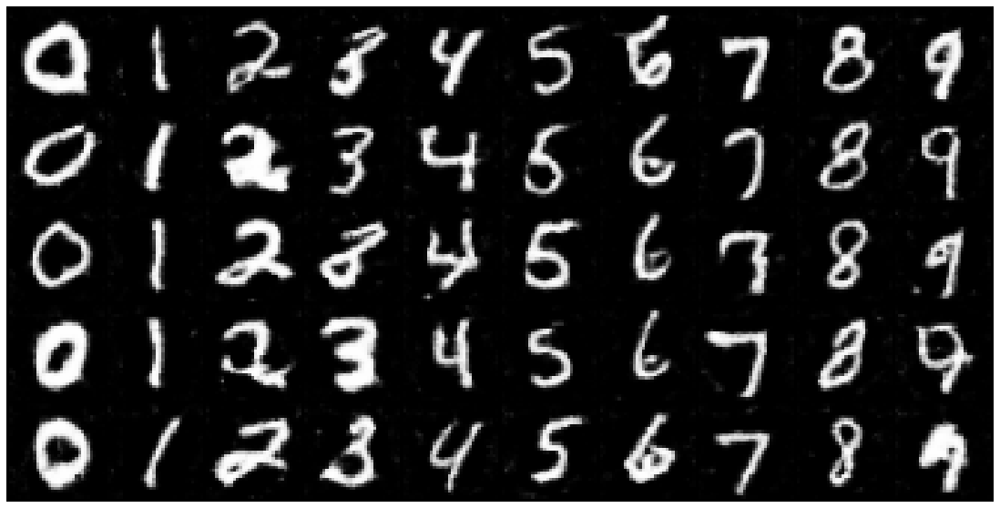

Epoch [12 / 20] G loss: 4.765022277832031 D loss: 0.03365138918161392


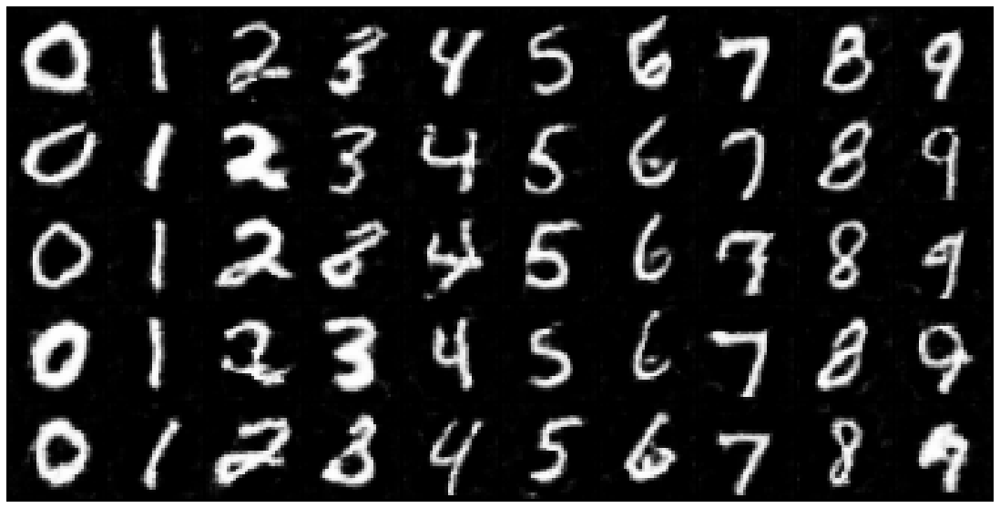

Epoch [13 / 20] G loss: 8.406669616699219 D loss: 0.057673078030347824


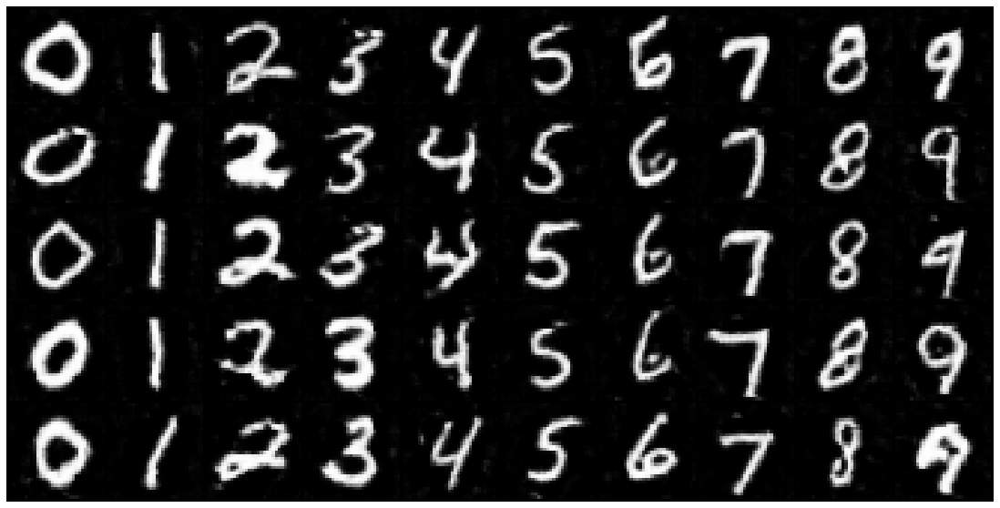

Epoch [14 / 20] G loss: 4.004175662994385 D loss: 0.06230665743350983


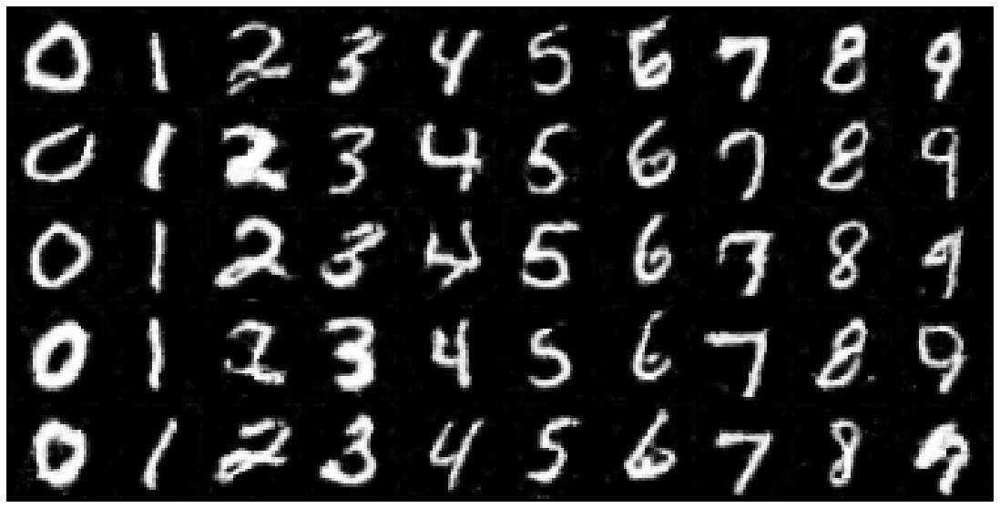

Epoch [15 / 20] G loss: 6.784942150115967 D loss: 0.014642421156167984


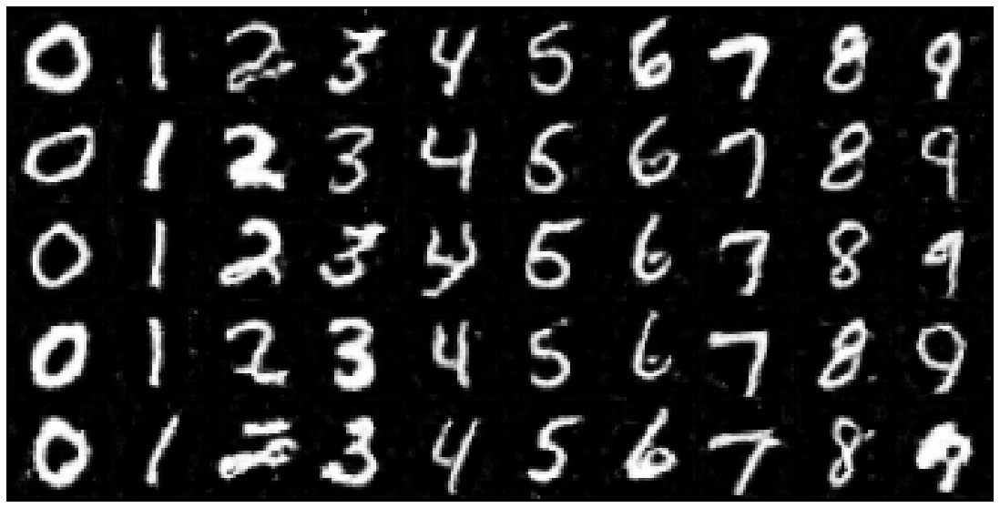

Epoch [16 / 20] G loss: 3.112739324569702 D loss: 0.33560648560523987


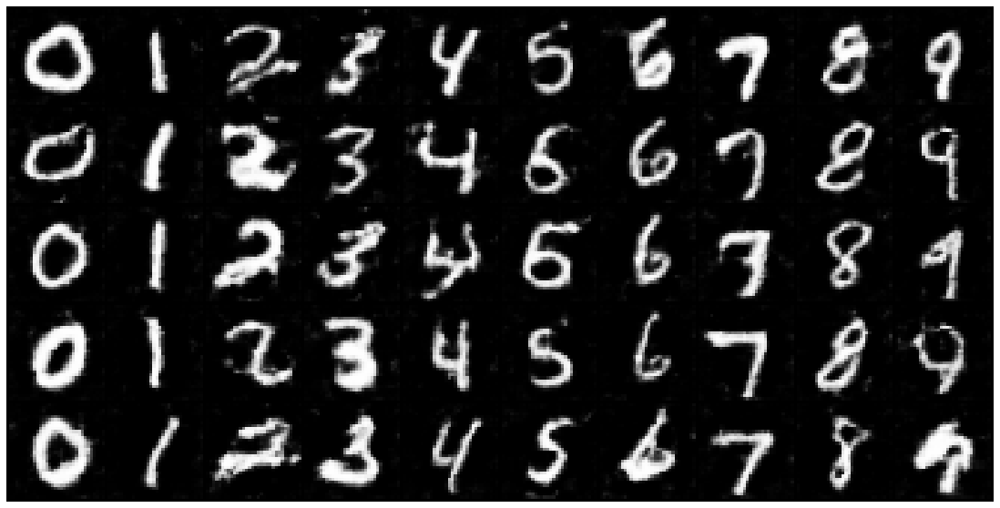

Epoch [17 / 20] G loss: 2.297914505004883 D loss: 0.24053727090358734


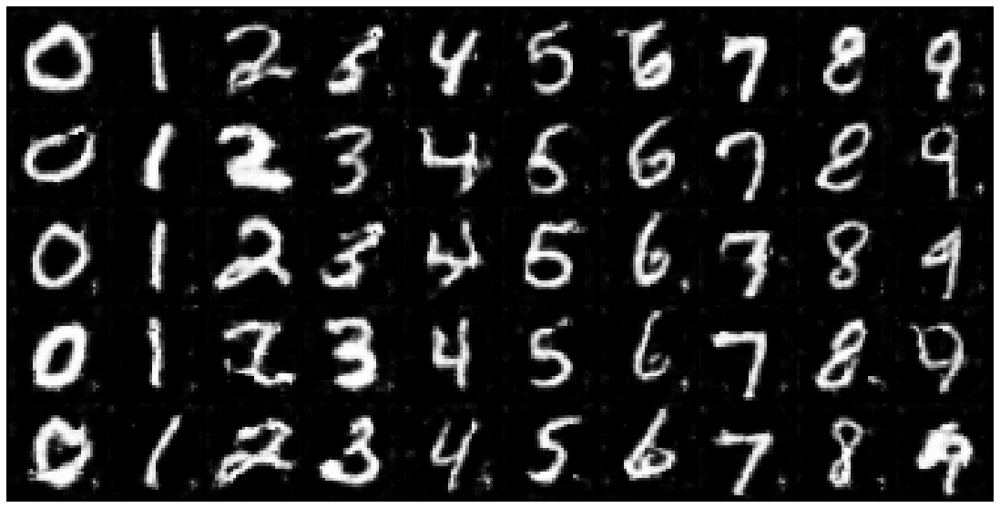

Epoch [18 / 20] G loss: 5.475780487060547 D loss: 0.021938098594546318


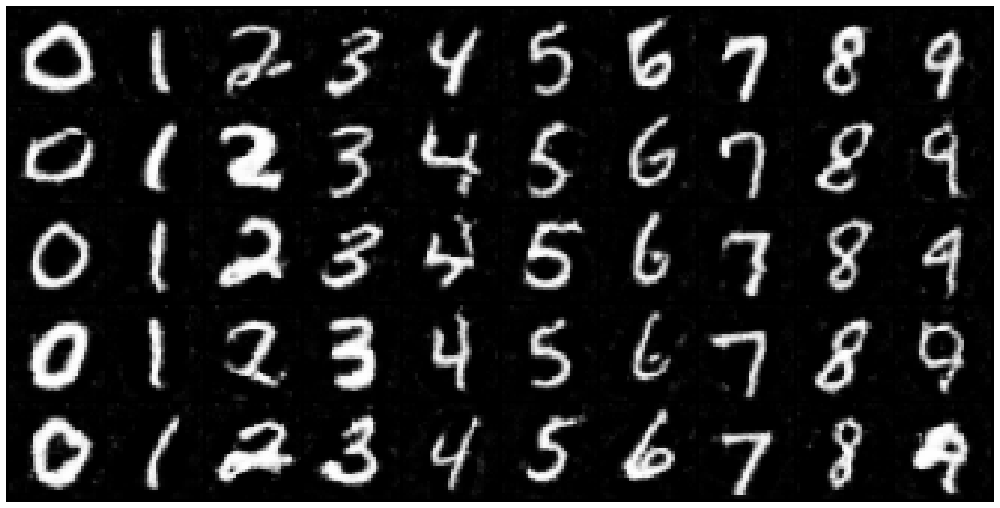

Epoch [19 / 20] G loss: 4.817195415496826 D loss: 0.025147559121251106


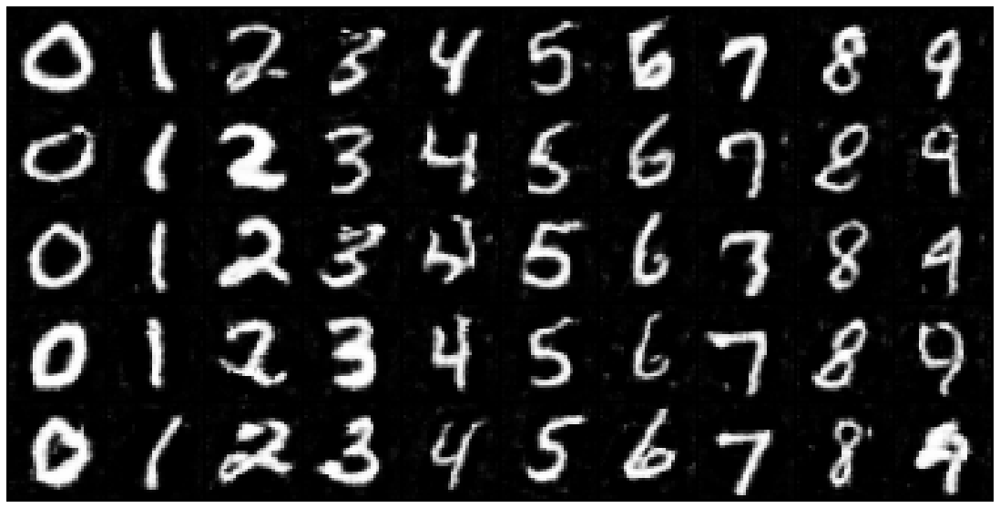

Epoch [20 / 20] G loss: 4.671739101409912 D loss: 0.03817844018340111


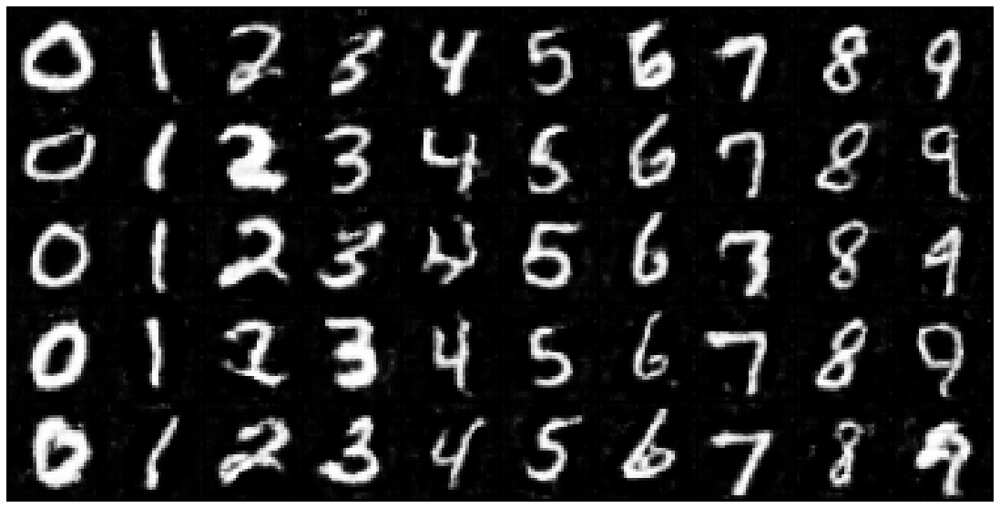

Avg per epoch time: 485.38 sec, total 20 epochs time: 161.97 min
Training finished!
...saving training results


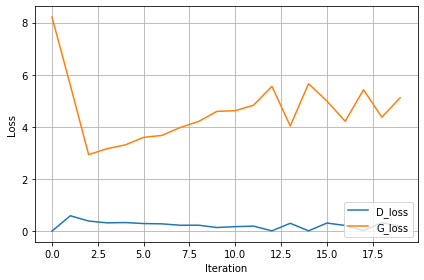

In [31]:
plt.ion()

# define dataloader
data_loader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
dset_name = 'mnist'
result_dir = '{}_conditional_DCGAN'.format(dset_name)

# results save folder
if not os.path.isdir(result_dir):
    os.mkdir(result_dir)
    
device = torch.device("cuda:0")

#######################################################################################################
# TODO 12: define training setup
#######################################################################################################

# TODO define networks
G = create_model_gpu(cGenerator)
G.apply(weight_init)
D = create_model_gpu(cDiscriminator)
D.apply(weight_init)

# TODO define optimizers
G_optimizer = optim.Adam(G.parameters(), lr=lr, betas=(0.5, 0.999))
D_optimizer = optim.Adam(D.parameters(), lr=lr, betas=(0.5, 0.999))

progress = {}
progress['D_losses'] = []
progress['G_losses'] = []
progress['per_epoch_times'] = []
progress['total_time'] = []
num_iter = 0

# start training loop
print('Training ...')
start_time = time.time()
for epoch in range(num_epochs):
    
    D_losses = []
    G_losses = []
    
    epoch_start_time = time.time()
    num_batches = 0
    
    for real, real_labels in data_loader:
        
        #######################################################################################################
        # TODO 13: Fill code for training loop
        #######################################################################################################

        # generate random latent vector z and random class assignments for each generated image in the minibatch as well as real and fake labels 
        real = real.to(device)
        real_labels = real_labels.to(device)
        batch_size = real.size(0)
        z = torch.randn(batch_size, 100, 1, 1, device=device)
        real_label = torch.full((batch_size, ), 1, device=device)
        fake_label = torch.full((batch_size, ), 0, device=device)        
        
        # generate fakes    
        fake_labels = torch.LongTensor(batch_size).random_(0, 10).to(device)
        fake = G(z, fake_labels) 
        
        # evaluate fakes       
        # fake as a leaf node(image)
        pred_fake = D(fake.detach(), fake_labels).view(-1) 
        loss_fake = F.binary_cross_entropy(pred_fake, fake_label, reduction='mean') 

      
        # evaluate real minibatch
        pred_real = D(real, real_labels).view(-1)
        loss_real = F.binary_cross_entropy(pred_real, real_label, reduction='mean')
        
        # accumulate discriminator loss from the information about the real and fake images it just saw
        D_train_loss = loss_fake + loss_real
         

        # train discriminator D step
        D.zero_grad()
        D_train_loss.backward()
        D_optimizer.step() 
        
        # train generator to output an image that is classified as real              
        G_train_loss = F.binary_cross_entropy(D(fake, fake_labels).view(-1), real_label, reduction='mean')  
        
        # train generator G step
        G.zero_grad()
        G_train_loss.backward()
        G_optimizer.step()              

        D_losses.append(D_train_loss.data.item())
        G_losses.append(G_train_loss.data.item())
        
        epoch_end_time = time.time()
    per_epoch_time = epoch_end_time - epoch_start_time
    
    print('Epoch [{} / {}] G loss: {} D loss: {}'.format(epoch + 1, num_epochs, G_train_loss, D_train_loss))

    show_conditional_result( epoch, save=True, show=True, path=result_dir + '/{}_conditional_DCGAN_{}.png'.format(dset_name, epoch), useFixed=True )
    progress['D_losses'].append(torch.mean(torch.FloatTensor(D_losses)))
    progress['G_losses'].append(torch.mean(torch.FloatTensor(G_losses)))
    progress['per_epoch_times'].append(per_epoch_time)
     
end_time = time.time()
total_time = end_time - start_time
progress['total_time'].append(total_time)

print('Avg per epoch time: {:.2f} sec, total {:d} epochs time: {:.2f} min'.format(torch.mean(torch.FloatTensor(progress['per_epoch_times'])), num_epochs, total_time / 60))
print('Training finished!')
print('...saving training results')

torch.save(G.state_dict(), result_dir + '/generator_network.pkl')
torch.save(D.state_dict(), result_dir + '/discriminator_network.pkl')
with open(result_dir + '/progress.pkl', 'wb') as f:
    pickle.dump(progress, f)

# plot loss curves
plot_losses(progress, save=True, path=result_dir + '/{}_DCGAN_progress.png'.format(dset_name))

# show training progress as animation
images = []
for e in range(num_epochs):
    img_name = result_dir + '/{}_conditional_DCGAN_{}.png'.format(dset_name, e)
    images.append(imageio.imread(img_name))
imageio.mimsave(result_dir + '/conditional_DCGAN_generation_animation.gif', images, fps=5)

### Display the animated generation GIF

% **TODO: edit path to GIF** %

<img src='mnist_conditional_DCGAN/conditional_DCGAN_generation_animation.gif' width="512">